In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
%cd '/content/drive/My Drive/saliency'

/content/drive/My Drive/saliency


## 0. Downloading Data 

In [3]:
import numpy as np
import cv2
import os 
import glob

In [4]:
#! pip install gdown

Manually do this step



1. Train Images -> images
2. Test Images -> test_images
3. Val Images -> val_images
4. Train maps -> train
5. Val maps -> val


#### Sometimes there will be error related to the data, it is because your drive is slow. Reload again.




In [5]:
# img_dir = "/content/drive/My Drive/saliency/ALLSTIMULI" # Enter Directory of all images  
# data_path = os.path.join(img_dir,'*g') 
# files = glob.glob(data_path) 
# allimg = [] 
# for f1 in files: 
#     img = cv2.imread(f1) 
#     img = cv2.resize(img, (500, 1024))
#     allimg.append(img)

# allimg = np.array(allimg)
# print(allimg.shape)

In [6]:
# map_dir = "/content/drive/My Drive/saliency/MAP"
# map_path = os.path.join(map_dir,'*g')
# mapfiles = glob.glob(map_path)
# alllabel = []
# for l1 in mapfiles:
#   label = cv2.imread(l1)
#   label = cv2.resize(label, (500, 1024))
#   alllabel.append(label)

# alllabel = np.array(alllabel)
# print(alllabel.shape)

In [7]:
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
import torch
import torch.nn as nn
import torchvision.models as models
import time
import torchvision.transforms as transforms
import time
import datetime
import matplotlib.pyplot as plt

imgs_train_path = 'images/'
maps_train_path = 'train/'

imgs_val_path = 'val_images/'
maps_val_path = 'val/'

In [8]:
# x_train, x_test, y_train, y_test = train_test_split(\
#                         allimg, alllabel, test_size=0.2, random_state=1)## test size: 20%
    
# x_train, x_val, y_train, y_val = train_test_split(x_train, y_train,\
#                                              test_size=0.25, random_state=1)## train size: 60%, val size: 20%

In [9]:
# print(x_train.shape)
# print(y_train.shape)
# print(x_val.shape)
# print(y_val.shape)
# print(x_test.shape)

In [10]:

def padding(img, shape_r=480, shape_c=640, channels=3):
  if channels == 1:
    img_padded = np.zeros((shape_r, shape_c), dtype=np.uint8)
  else:
    img_padded = np.zeros((shape_r, shape_c, channels), dtype=np.uint8)
    

  original_shape = img.shape
  print("original: ",original_shape)
  
  rows_rate = original_shape[0]/shape_r
  cols_rate = original_shape[1]/shape_c
  print("row rate: ",rows_rate)
  print("col_rate: ",cols_rate)
 
  
  if rows_rate > cols_rate:
    new_cols = (original_shape[1] * shape_r) // original_shape[0]
    img = cv2.resize(img, (new_cols, shape_r))
    print("> img size: ",img.shape)
     
    if new_cols >= shape_c:
      new_cols = shape_c
      img_padded[:, ((img_padded.shape[1] - new_cols) // 2):((img_padded.shape[1] - new_cols) // 2 + new_cols)] = img
      print("> pad size: ",img_padded.shape)

    
  else:
    new_rows = (original_shape[0] * shape_c) // original_shape[1]
    img = cv2.resize(img, (shape_c, new_rows))
    print("< img size: ",img.shape)

    if new_rows >= shape_r:
      new_rows = shape_r
      img_padded[((img_padded.shape[0] - new_rows) // 2):((img_padded.shape[0] - new_rows) // 2 + new_rows), :] = img
      print("< pad size: ",img_padded.shape)


  
  return img_padded


In [11]:

def preprocess_images(paths, shape_r, shape_c):
    ims = np.zeros((len(paths), shape_r, shape_c, 3))


    for i, path in enumerate(paths):
        original_image = cv2.imread(path)
        padded_image = cv2.resize(original_image,(shape_c,shape_r))
        #padded_image = padding(original_image, shape_r, shape_c, 3)
        ims[i] = padded_image.astype('float')

    ims = ims[...,::-1]
    ims /= 255.0
    ims = np.rollaxis(ims, 3, 1) 


    return ims


def preprocess_maps(paths, shape_r, shape_c):
    ims = np.zeros((len(paths), 1, shape_r, shape_c))

    for i, path in enumerate(paths):
        original_map = cv2.imread(path, 0)
        #padded_map = padding(original_map, shape_r, shape_c, 1)
        padded_map = cv2.resize(original_map,(shape_c,shape_r))
        ims[i, 0] = padded_map.astype(np.float32)
        ims[i, 0] /= 255.0
        

    return ims
# def preprocess_images(original_image, shape_r, shape_c):
#   ims = np.zeros((len(original_image), shape_r, shape_c, 3))
  
#   for i in range(ims.shape[0]):
#     padded_image = padding(original_image[i], shape_r, shape_c, 3)
#     ims[i] = padded_image.astype('float')
   
    
#   ims = ims[...,::-1]
#   ims /= 255.0
#   ims = np.rollaxis(ims, 3, 1)  
#   return ims


# def preprocess_maps(original_map, shape_r, shape_c):
#   ims = np.zeros((len(original_map), 1, shape_r, shape_c))

#   for i in range(ims.shape[0]):
#       padded_map = padding(original_map[i], shape_r, shape_c, 1)
#       ims[i, 0] = padded_map.astype(np.float32)
#       ims[i, 0] /= 255.0
        

#   return ims

In [12]:
def generator(b_s, phase_gen='train'):
    if phase_gen == 'train':
        images = [imgs_train_path + f for f in os.listdir(imgs_train_path)if f.endswith('.jpeg')]
        maps = [maps_train_path + f for f in os.listdir(maps_train_path)if f.endswith('.jpg')]
    elif phase_gen == 'val':
        images = [imgs_val_path + f for f in os.listdir(imgs_val_path) if f.endswith('.jpeg')]
        maps = [maps_val_path + f for f in os.listdir(maps_val_path) if f.endswith('.jpg')]
    else:
        raise NotImplementedError


    images.sort()
    maps.sort()

    counter = 0
    
    
    
    while True:
        yield preprocess_images(images[counter:counter + b_s], shape_r, shape_c), preprocess_maps(maps[counter:counter + b_s], shape_r_gt, shape_c_gt)
        if counter + b_s >= len(images):
          break
        counter = counter + b_s
# def generator(b_s, x_train, y_train, x_val, y_val, phase_gen='train'):
#   if phase_gen == 'train':
#       images = x_train
#       maps = y_train
#   elif phase_gen == 'val':
#       images = x_val
#       maps = y_val
#   else:
#       raise NotImplementedError

#   images.sort()
#   maps.sort()
#   counter = 0
  
#   while True:
#       yield preprocess_images(images[counter:counter + b_s], shape_r, shape_c), preprocess_maps(maps[counter:counter + b_s], shape_r_gt, shape_c_gt)
#       if counter + b_s >= len(images):
#         break
#       counter = counter + b_s

In [13]:
!pip3 install torchvision

### Model


In [14]:
import torch
import torch.nn as nn
import torchvision.models as models


class MLNet(nn.Module):
  
  def __init__(self,prior_size):
    super(MLNet, self).__init__()
    features = list(models.vgg16(pretrained = True).features)[:-1]
    # print("features: ",features)
    features[23].stride = 1
    features[23].kernel_size = 5
    features[23].padding = 2
            
    self.features = nn.ModuleList(features).train() 
    self.fddropout = nn.Dropout2d(p=0.5)
    self.int_conv = nn.Conv2d(1280,64,kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    self.pre_final_conv = nn.Conv2d(64,1,kernel_size=(1, 1), stride=(1, 1) ,padding=(0, 0))
    self.prior = nn.Parameter(torch.ones((1,1,prior_size[0],prior_size[1]), requires_grad=True))
    self.bilinearup = torch.nn.UpsamplingBilinear2d(scale_factor=10)
    self.attention1= AttentionStem(in_channels=1280, out_channels=64, kernel_size=4, stride=1, padding=2, groups=1)
    self.attention2 = AttentionStem(in_channels=64, out_channels=1, kernel_size=4, stride=1, padding=2, groups=1)
      
  def forward(self, x):
      
    results = []
    for ii,model in enumerate(self.features):
        x = model(x)
        if ii in {16,23,29}:
            results.append(x)

    # concat to get 1280 = 512 + 512 + 256
    x = torch.cat((results[0],results[1],results[2]),1) 
    
  
    x = self.fddropout(x)
    #x = self.attention1(x)
    
    x = self.int_conv(x)
    #x = self.attention2(x)
    x = self.pre_final_conv(x)
    # print('pre prior: ',x)
    
    upscaled_prior = self.bilinearup(self.prior)
    # print ("upscaled_prior shape: {}".format(upscaled_prior.shape))

    # dot product with prior
    x = x * upscaled_prior
    # print("post prior: ",x)
    
    x = torch.nn.functional.relu(x,inplace=True)

    return x


In [15]:
# import torch
# import torch.nn as nn
# import torch.nn.functional as F
# import torch.nn.init as init

# import math


# class AttentionConv(nn.Module):
#     def __init__(self, in_channels, out_channels, kernel_size, stride=1, padding=0, groups=1, bias=False):
#         super(AttentionConv, self).__init__()
#         self.out_channels = out_channels
#         self.kernel_size = kernel_size
#         self.stride = stride
#         self.padding = padding
#         self.groups = groups

#         assert self.out_channels % self.groups == 0, "out_channels should be divided by groups. (example: out_channels: 40, groups: 4)"

#         self.rel_h = nn.Parameter(torch.randn(out_channels // 2, 1, 1, kernel_size, 1), requires_grad=True)
#         self.rel_w = nn.Parameter(torch.randn(out_channels // 2, 1, 1, 1, kernel_size), requires_grad=True)

#         self.key_conv = nn.Conv2d(in_channels, out_channels, kernel_size=1, bias=bias)
#         self.query_conv = nn.Conv2d(in_channels, out_channels, kernel_size=1, bias=bias)
#         self.value_conv = nn.Conv2d(in_channels, out_channels, kernel_size=1, bias=bias)

#         self.reset_parameters()

#     def forward(self, x):
#         batch, channels, height, width = x.size()

#         padded_x = F.pad(x, [self.padding, self.padding, self.padding, self.padding])
#         q_out = self.query_conv(x)
#         k_out = self.key_conv(padded_x)
#         v_out = self.value_conv(padded_x)

#         k_out = k_out.unfold(2, self.kernel_size, self.stride).unfold(3, self.kernel_size, self.stride)
#         v_out = v_out.unfold(2, self.kernel_size, self.stride).unfold(3, self.kernel_size, self.stride)

#         k_out_h, k_out_w = k_out.split(self.out_channels // 2, dim=1)
#         k_out = torch.cat((k_out_h + self.rel_h, k_out_w + self.rel_w), dim=1)

#         k_out = k_out.contiguous().view(batch, self.groups, self.out_channels // self.groups, height, width, -1)
#         v_out = v_out.contiguous().view(batch, self.groups, self.out_channels // self.groups, height, width, -1)

#         q_out = q_out.view(batch, self.groups, self.out_channels // self.groups, height, width, 1)

#         out = q_out * k_out
#         out = F.softmax(out, dim=-1)
#         out = torch.einsum('bnchwk,bnchwk -> bnchw', out, v_out).view(batch, -1, height, width)

#         return out

#     def reset_parameters(self):
#         init.kaiming_normal_(self.key_conv.weight, mode='fan_out', nonlinearity='relu')
#         init.kaiming_normal_(self.value_conv.weight, mode='fan_out', nonlinearity='relu')
#         init.kaiming_normal_(self.query_conv.weight, mode='fan_out', nonlinearity='relu')

#         init.normal_(self.rel_h, 0, 1)
#         init.normal_(self.rel_w, 0, 1)


# class AttentionStem(nn.Module):
#     def __init__(self, in_channels, out_channels, kernel_size, stride=1, padding=0, groups=1, m=4, bias=False):
#         super(AttentionStem, self).__init__()
#         self.out_channels = out_channels
#         self.kernel_size = kernel_size
#         self.stride = stride
#         self.padding = padding
#         self.groups = groups
#         self.m = m

#         assert self.out_channels % self.groups == 0, "out_channels should be divided by groups. (example: out_channels: 40, groups: 4)"

#         self.emb_a = nn.Parameter(torch.randn(out_channels // groups, kernel_size), requires_grad=True)
#         self.emb_b = nn.Parameter(torch.randn(out_channels // groups, kernel_size), requires_grad=True)
#         self.emb_mix = nn.Parameter(torch.randn(m, out_channels // groups), requires_grad=True)

#         self.key_conv = nn.Conv2d(in_channels, out_channels, kernel_size=1, bias=bias)
#         self.query_conv = nn.Conv2d(in_channels, out_channels, kernel_size=1, bias=bias)
#         self.value_conv = nn.ModuleList([nn.Conv2d(in_channels, out_channels, kernel_size=1, bias=bias) for _ in range(m)])

#         self.reset_parameters()

#     def forward(self, x):
#         batch, channels, height, width = x.size()

#         padded_x = F.pad(x, [self.padding, self.padding, self.padding, self.padding])

#         q_out = self.query_conv(x)
#         k_out = self.key_conv(padded_x)
#         v_out = torch.stack([self.value_conv[_](padded_x) for _ in range(self.m)], dim=0)

#         k_out = k_out.unfold(2, self.kernel_size, self.stride).unfold(3, self.kernel_size, self.stride)
#         v_out = v_out.unfold(3, self.kernel_size, self.stride).unfold(4, self.kernel_size, self.stride)

#         k_out = k_out[:, :, :height, :width, :, :]
#         v_out = v_out[:, :, :, :height, :width, :, :]

#         emb_logit_a = torch.einsum('mc,ca->ma', self.emb_mix, self.emb_a)
#         emb_logit_b = torch.einsum('mc,cb->mb', self.emb_mix, self.emb_b)
#         emb = emb_logit_a.unsqueeze(2) + emb_logit_b.unsqueeze(1)
#         emb = F.softmax(emb.view(self.m, -1), dim=0).view(self.m, 1, 1, 1, 1, self.kernel_size, self.kernel_size)

#         v_out = emb * v_out

#         k_out = k_out.contiguous().view(batch, self.groups, self.out_channels // self.groups, height, width, -1)
#         v_out = v_out.contiguous().view(self.m, batch, self.groups, self.out_channels // self.groups, height, width, -1)
#         v_out = torch.sum(v_out, dim=0).view(batch, self.groups, self.out_channels // self.groups, height, width, -1)

#         q_out = q_out.view(batch, self.groups, self.out_channels // self.groups, height, width, 1)

#         out = q_out * k_out
#         out = F.softmax(out, dim=-1)
#         out = torch.einsum('bnchwk,bnchwk->bnchw', out, v_out).view(batch, -1, height, width)

#         return out

#     def reset_parameters(self):
#         init.kaiming_normal_(self.key_conv.weight, mode='fan_out', nonlinearity='relu')
#         init.kaiming_normal_(self.query_conv.weight, mode='fan_out', nonlinearity='relu')
#         for _ in self.value_conv:
#             init.kaiming_normal_(_.weight, mode='fan_out', nonlinearity='relu')

#         init.normal_(self.emb_a, 0, 1)
#         init.normal_(self.emb_b, 0, 1)
#         init.normal_(self.emb_mix, 0, 1)

### Custom Loss function

## With Prior

In [16]:
# Modified MSE Loss Function
class ModMSELoss(torch.nn.Module):
  def __init__(self,shape_r_gt,shape_c_gt):
    super(ModMSELoss, self).__init__()
    self.shape_r_gt = shape_r_gt
    self.shape_c_gt = shape_c_gt
      
  def forward(self, output , label , prior):
    prior_size = prior.shape
    output_max = torch.max(torch.max(output,2)[0],2)[0].unsqueeze(2).unsqueeze(2).expand(output.shape[0],output.shape[1],self.shape_r_gt,self.shape_c_gt)
    reg = ( 1.0/(prior_size[0]*prior_size[1]) ) * ( 1 - prior)**2
    loss = torch.mean( ((output / output_max) - label)**2 / (1 - label + 0.1) )  +  torch.sum(reg)
    return loss

## Training Model

In [17]:
shape_r = 240
shape_c = 320
shape_r_gt = 30
shape_c_gt = 40
last_freeze_layer = 23

In [18]:
prior_size = ( int(shape_r_gt / 10) , int(shape_c_gt / 10) )
model = MLNet(prior_size).cuda()
# freezing Layer
for i,param in enumerate(model.parameters()):
  if i < last_freeze_layer:
    param.requires_grad = False
#criterion =  nn.MSELoss()
criterion = ModMSELoss(shape_r_gt,shape_c_gt).cuda()
#optimizer = torch.optim.SGD(model.parameters(), lr=1e-6,weight_decay=0.0005,momentum=0.9,nesterov=True)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-6,weight_decay=1e-4)

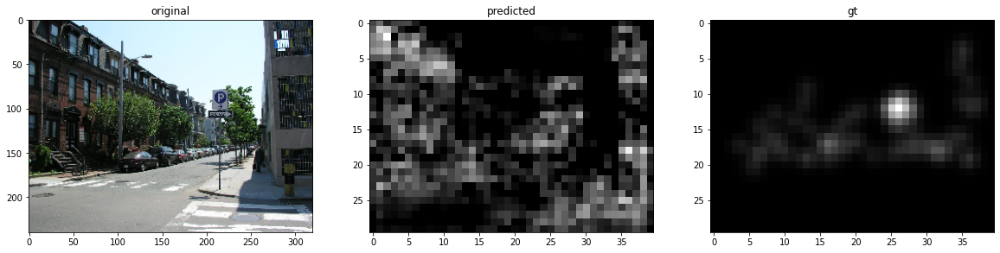

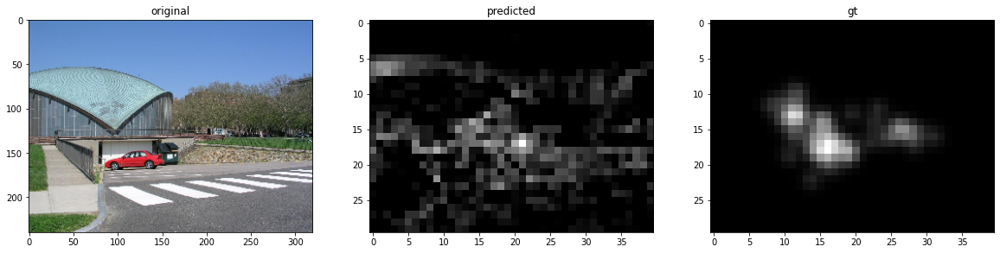

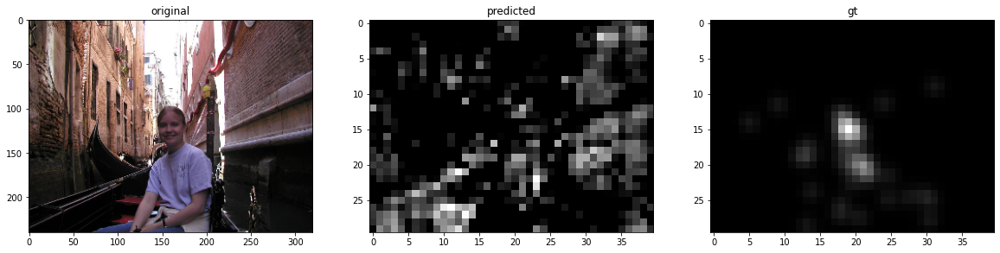

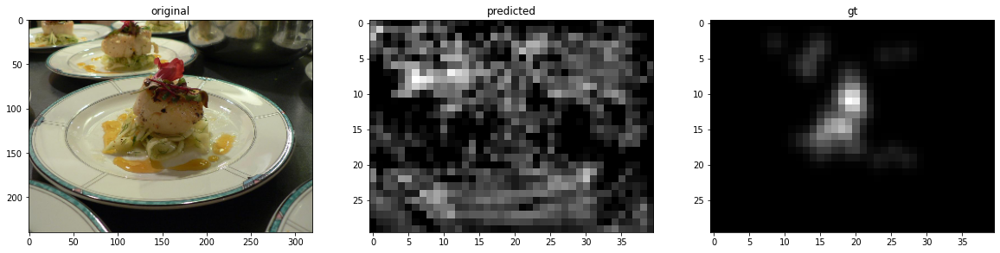

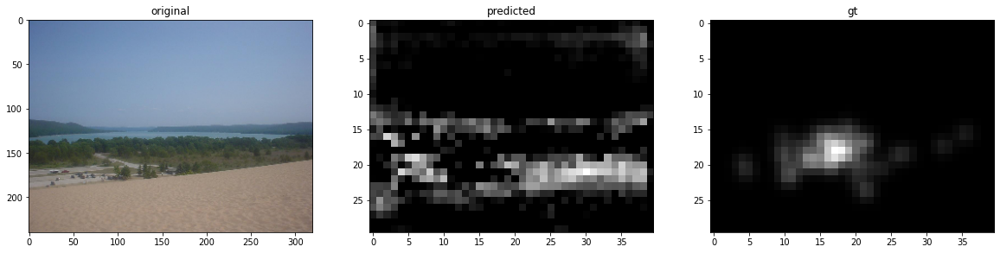

Epochs:0 Images:25 Loss:0.05551191791892052


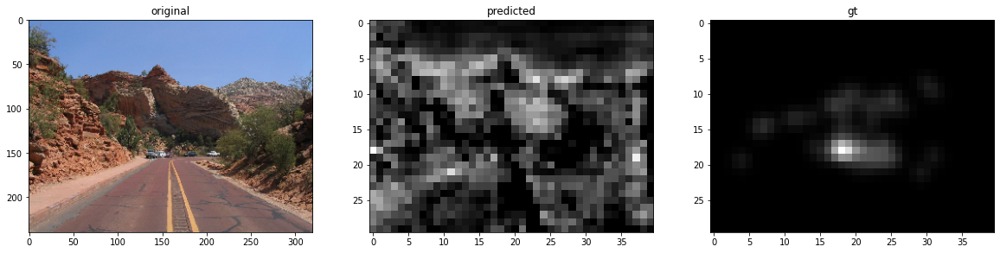

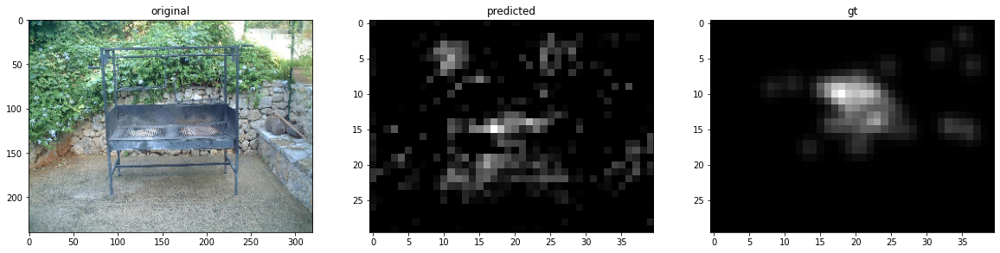

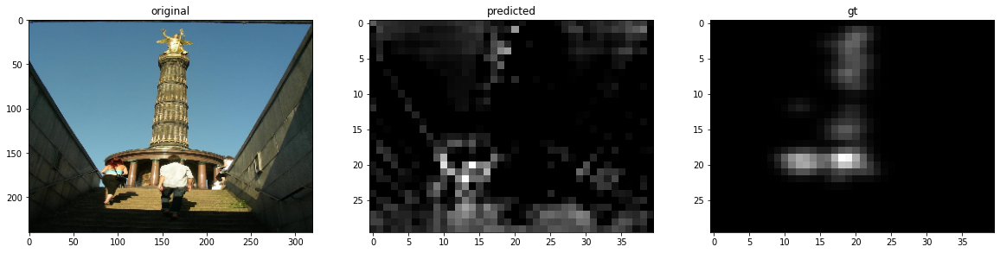

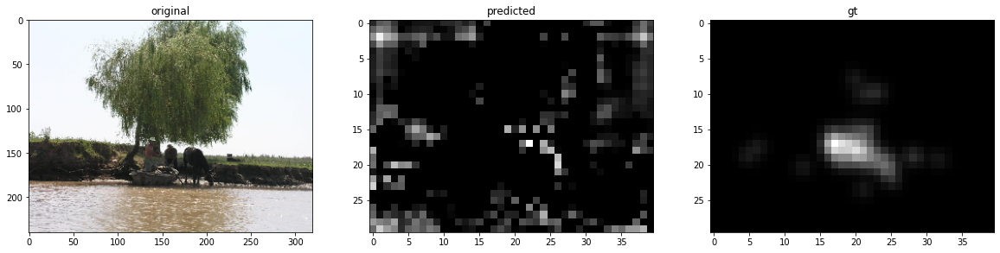

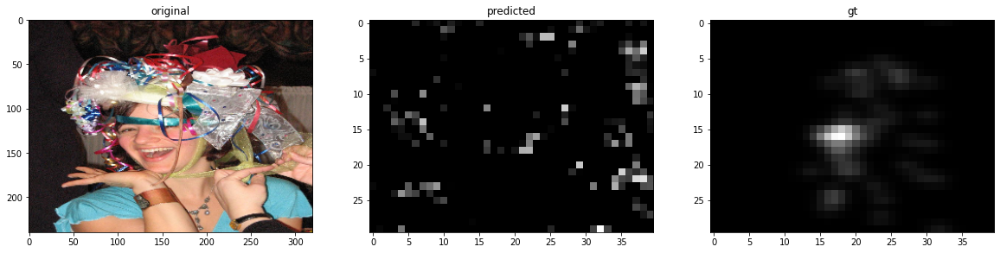

Epochs:0 Images:50 Loss:0.05901198089122772


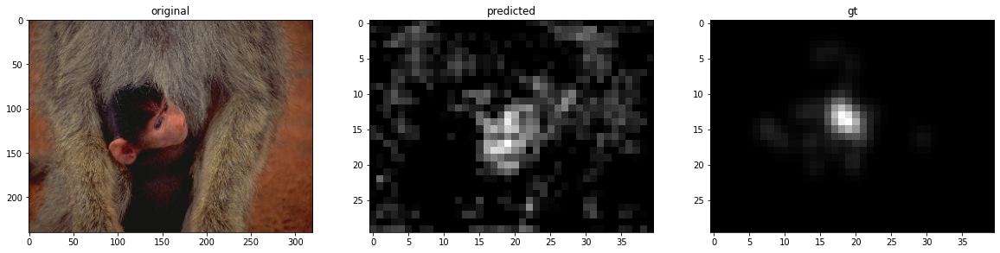

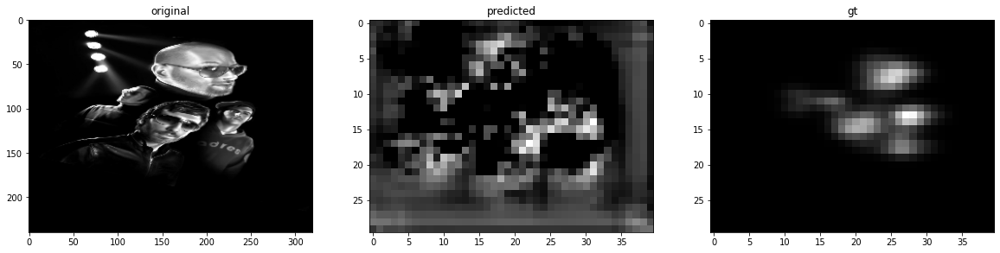

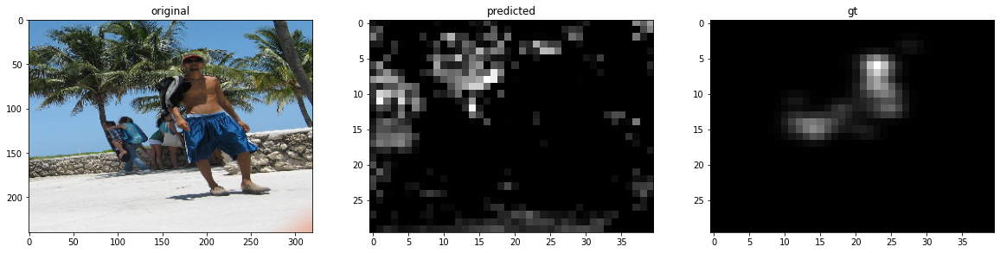

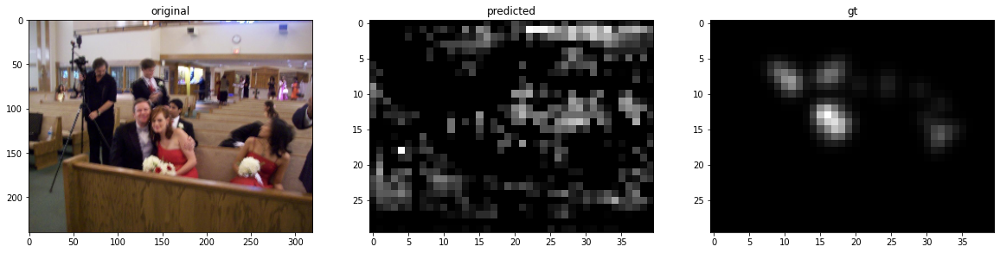

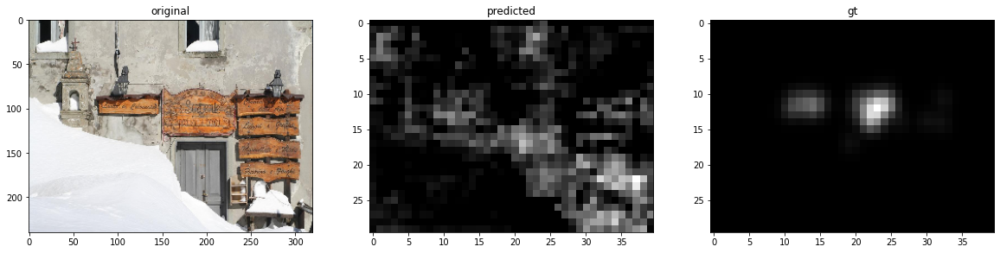

Epochs:0 Images:75 Loss:0.034099940210580826


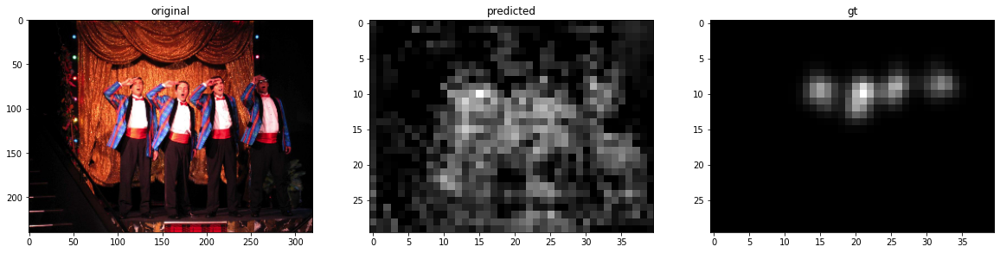

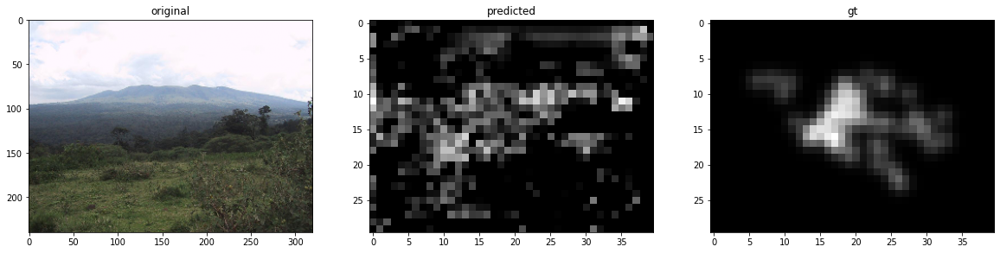

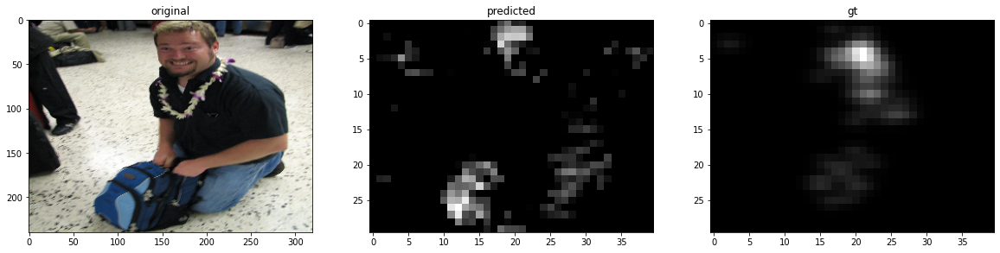

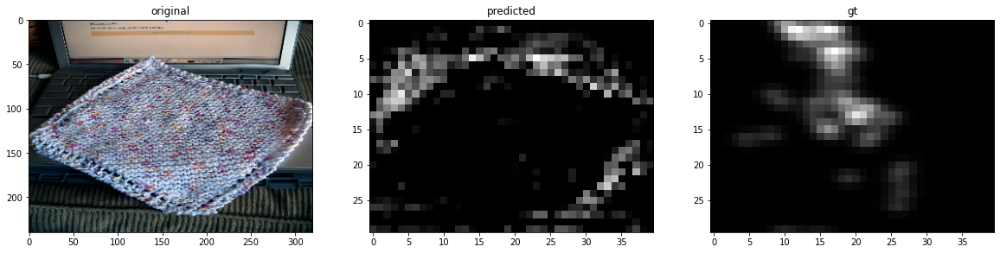

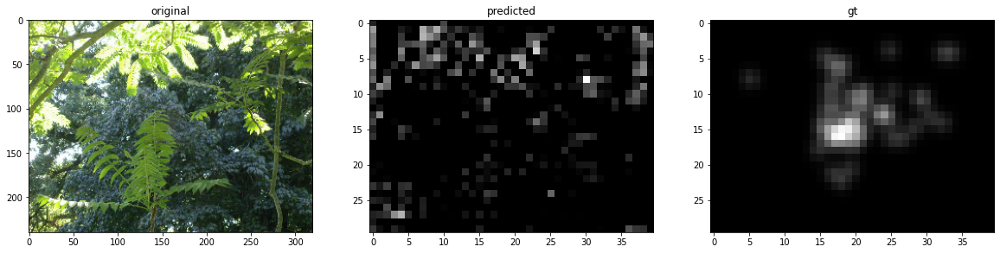

Epochs:0 Images:100 Loss:0.048274025321006775


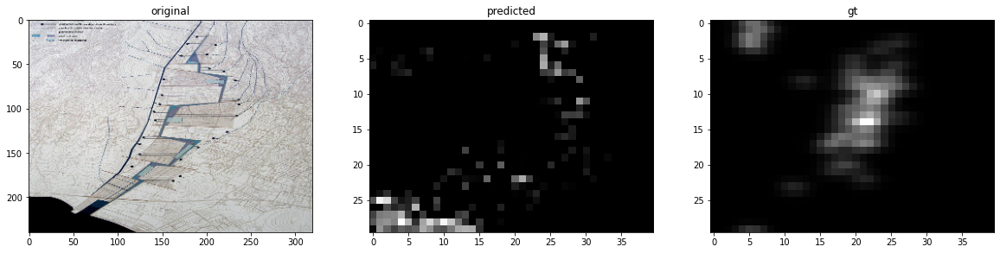

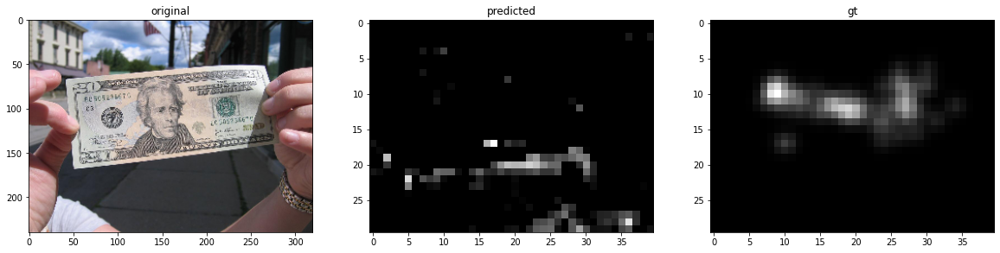

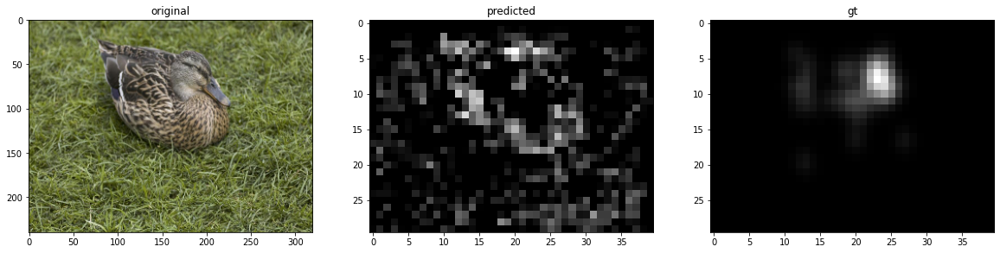

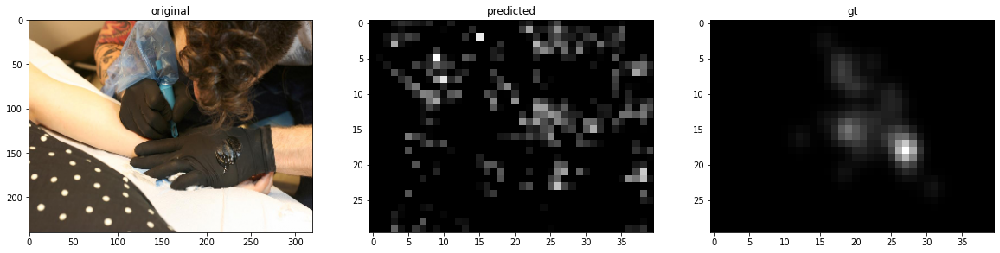

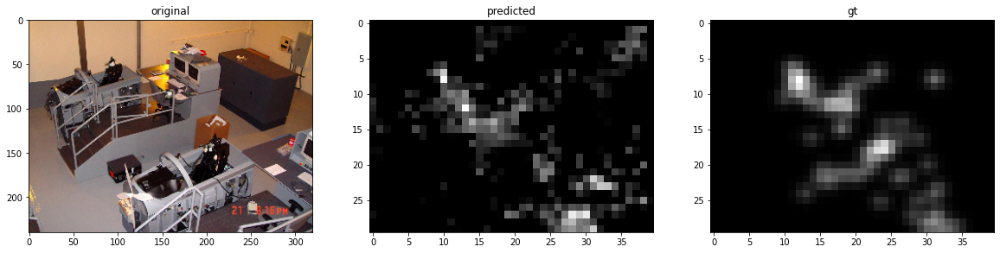

Epochs:0 Images:125 Loss:0.04706081002950668


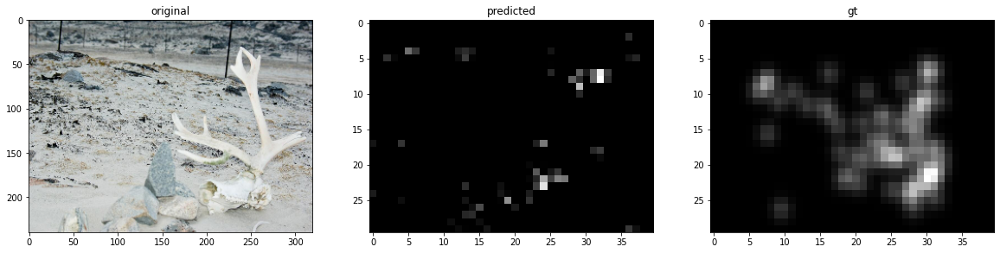

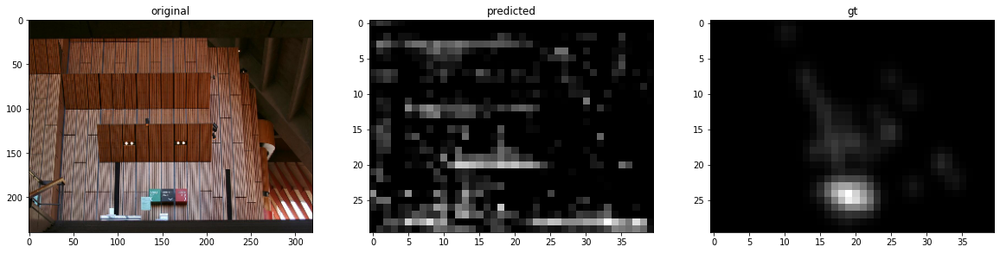

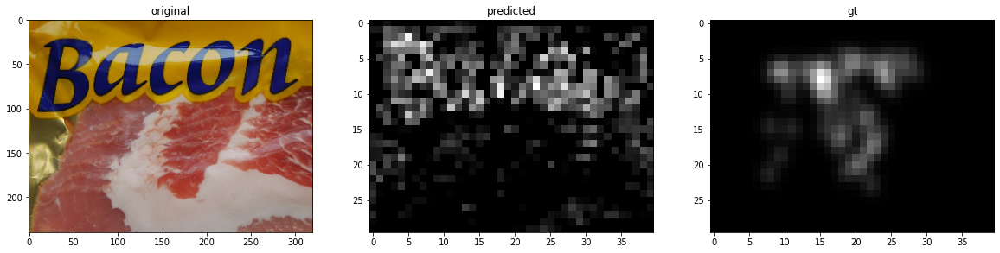

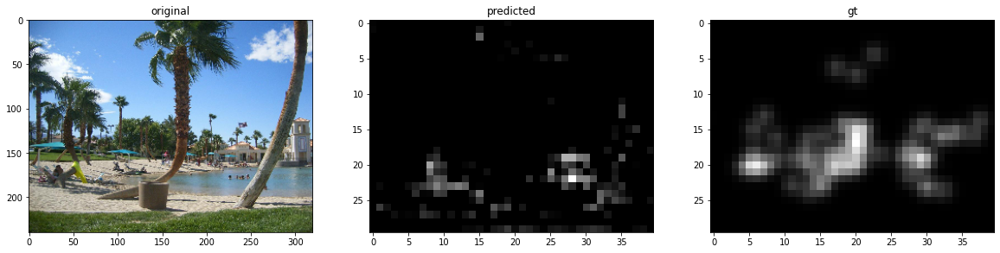

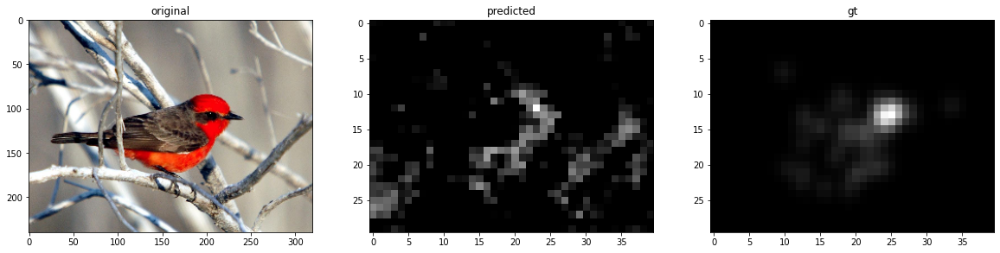

Epochs:0 Images:150 Loss:0.03542894124984741


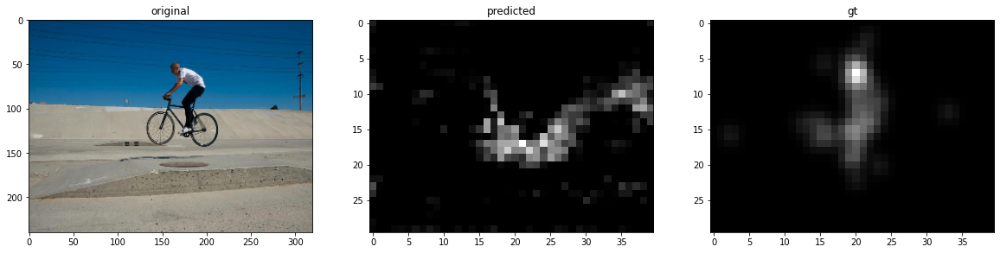

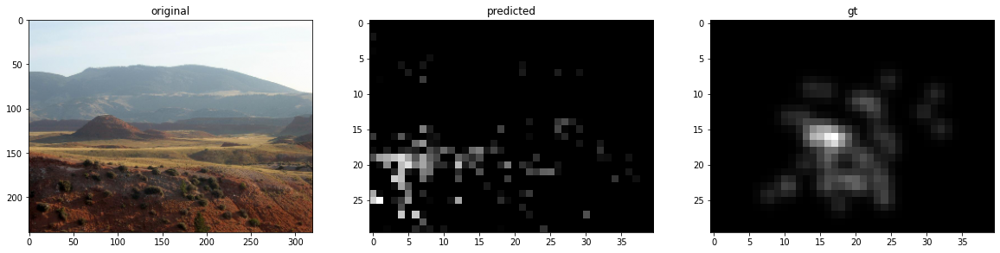

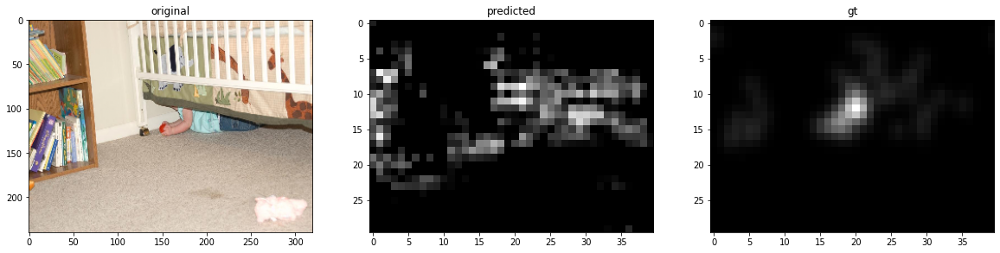

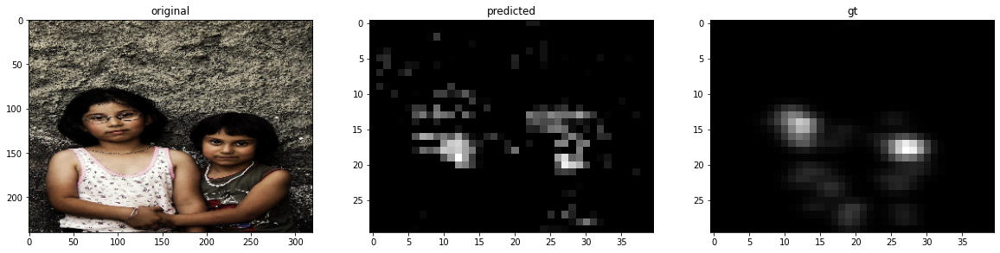

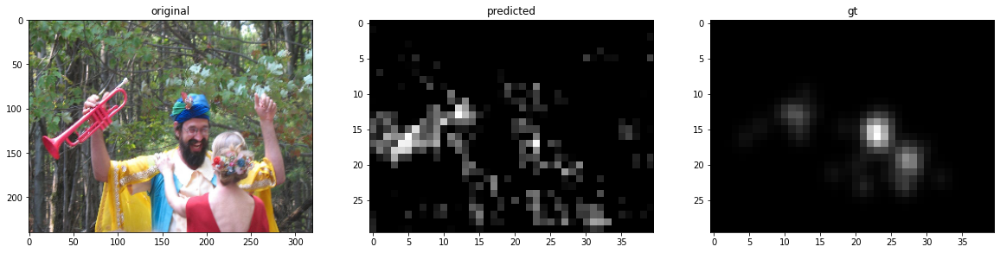

Epochs:0 Images:175 Loss:0.04787620157003403


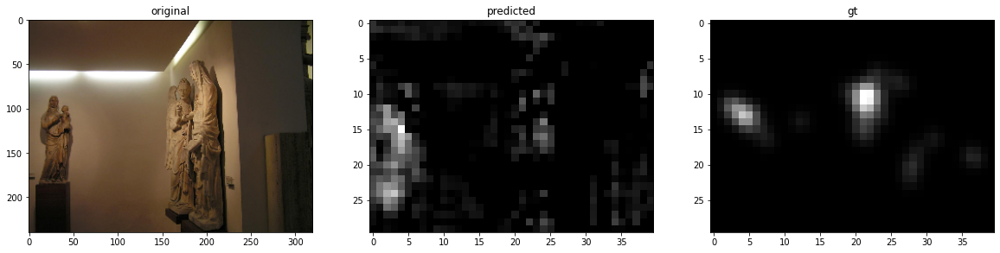

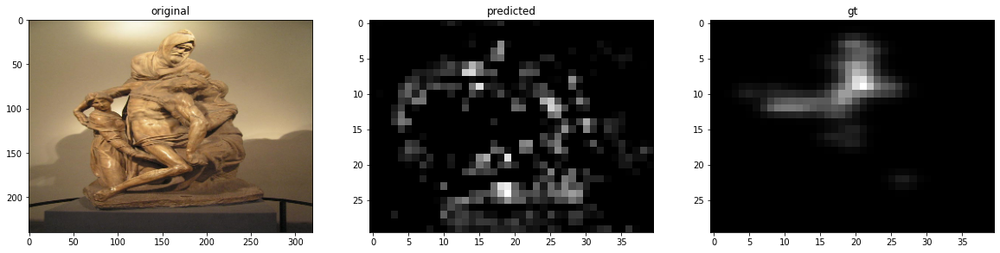

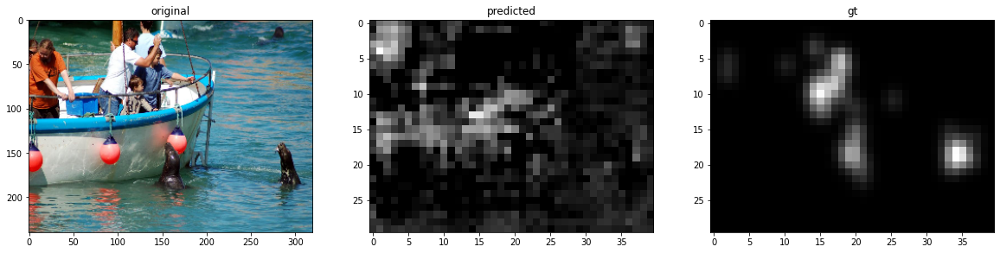

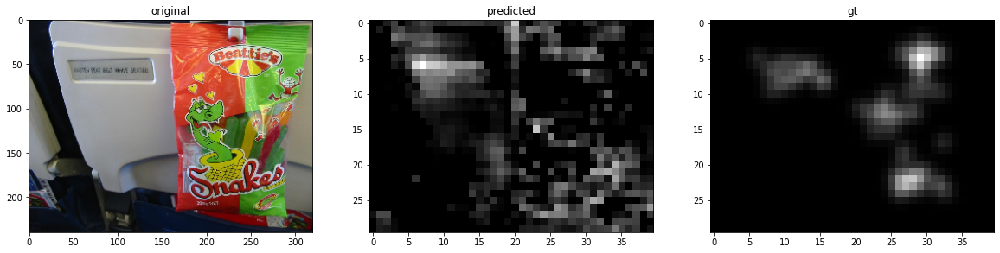

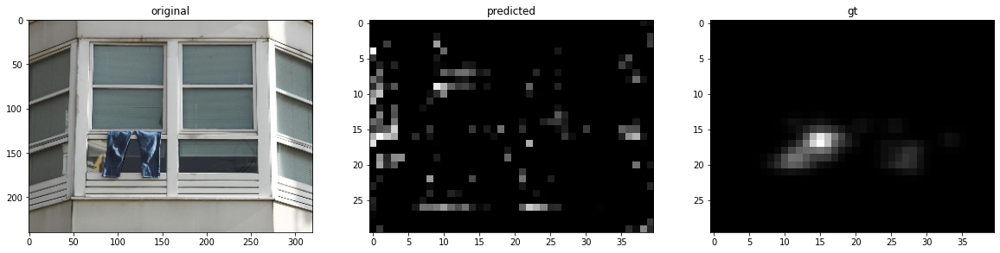

Epochs:0 Images:200 Loss:0.034516166895627975


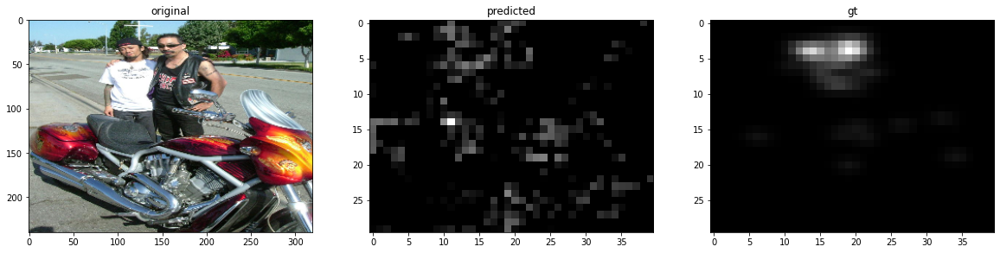

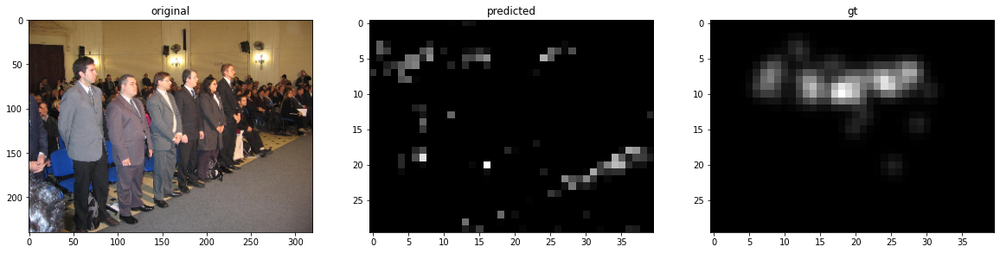

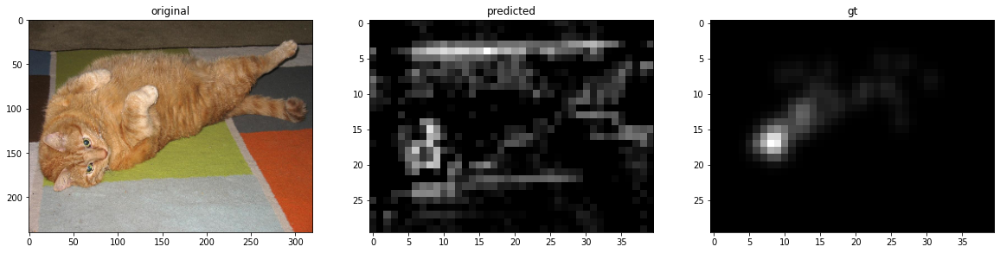

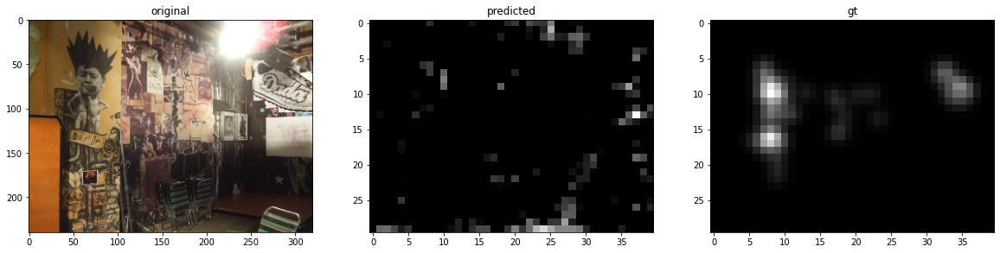

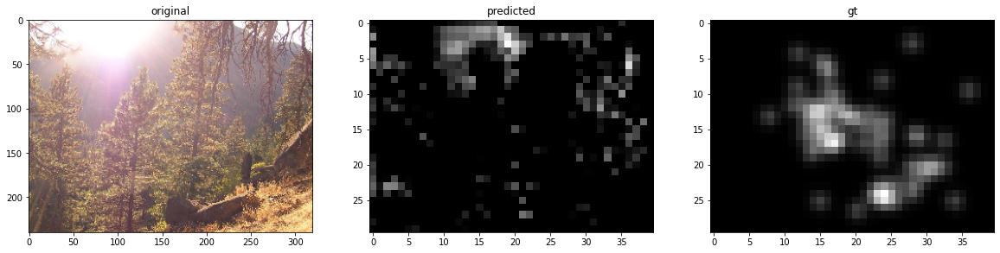

Epochs:0 Images:225 Loss:0.03608187660574913


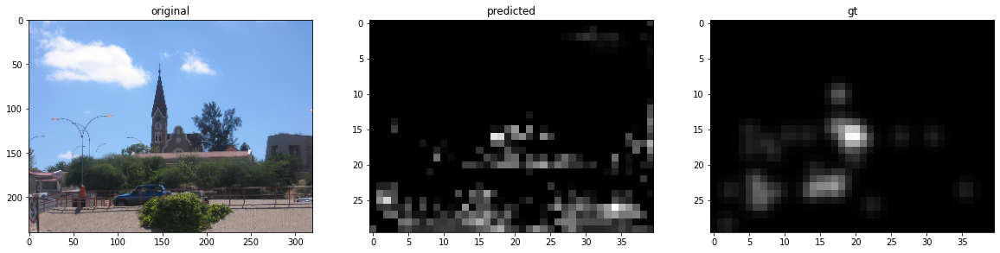

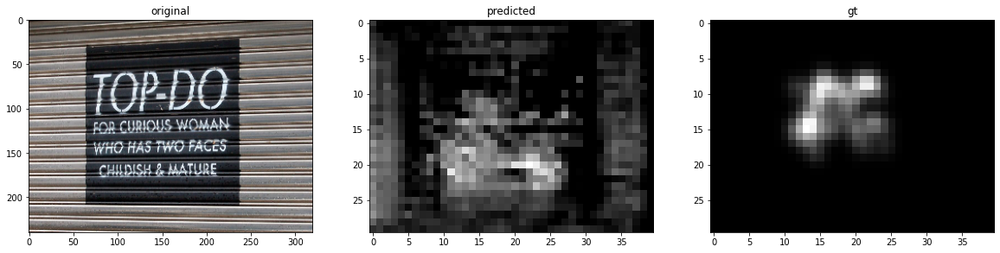

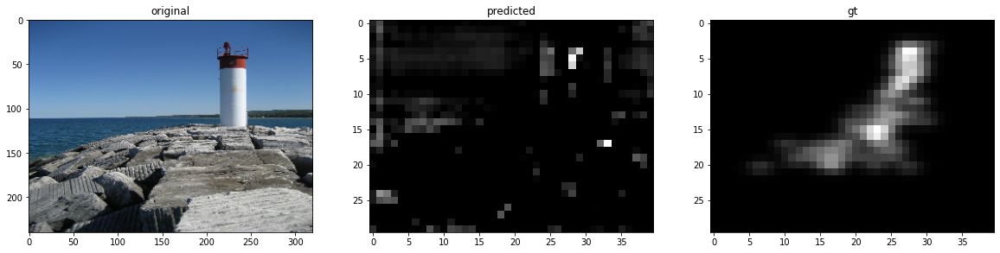

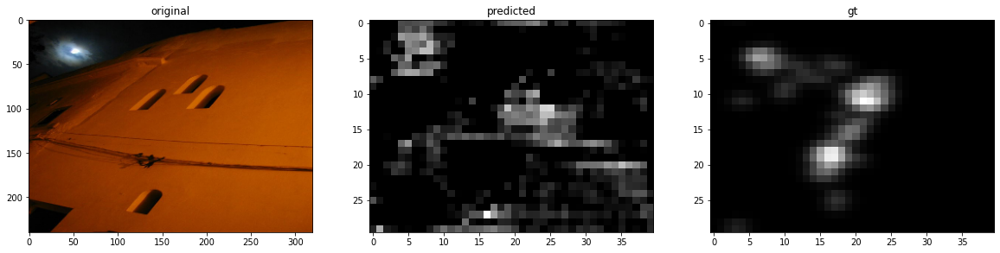

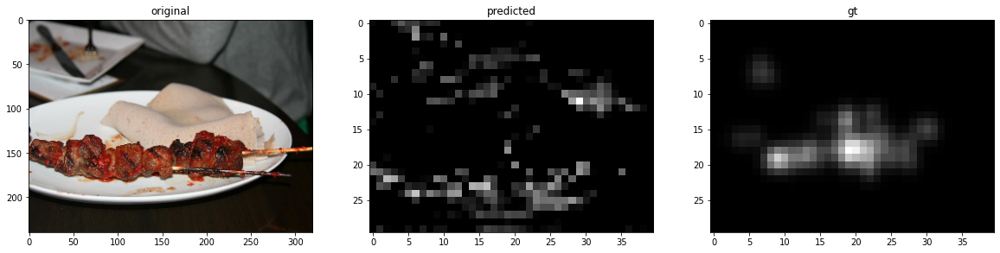

Epochs:0 Images:250 Loss:0.043259408324956894


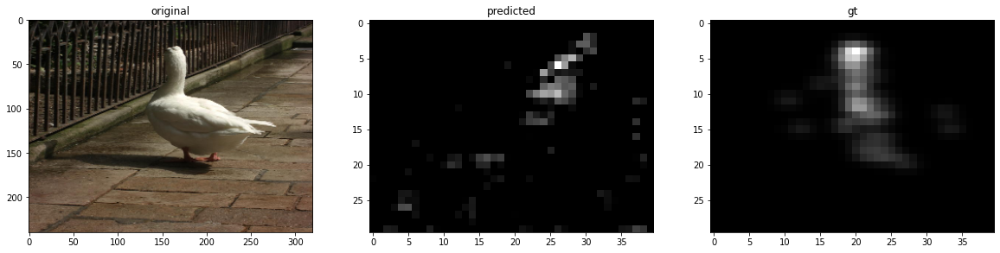

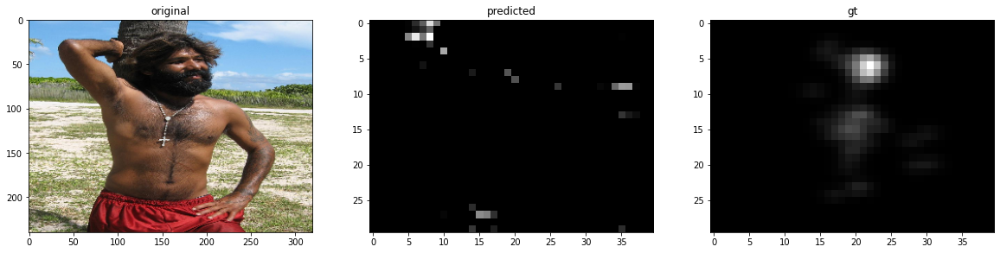

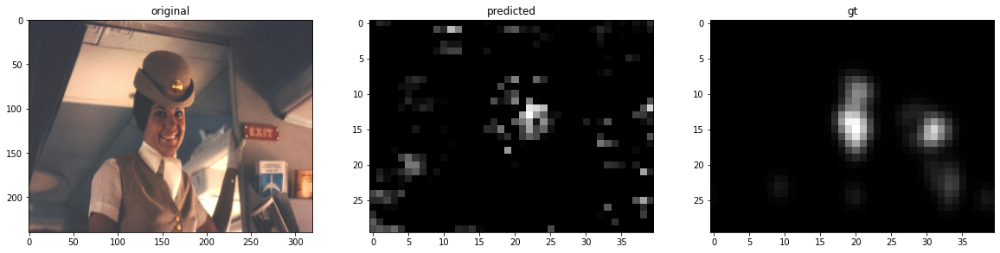

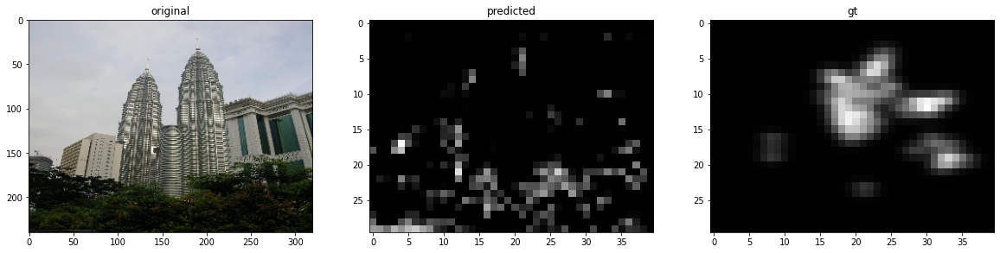

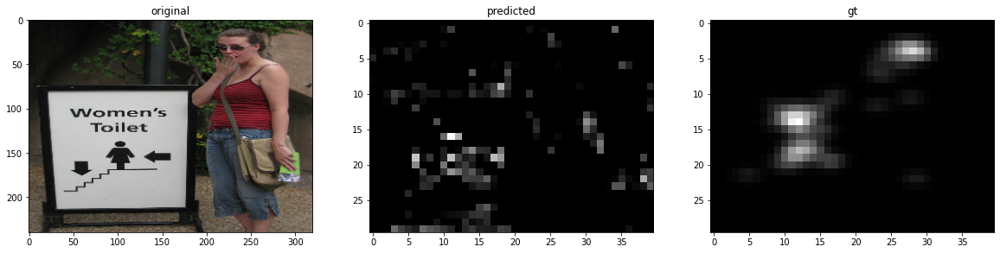

Epochs:0 Images:275 Loss:0.0365021750330925


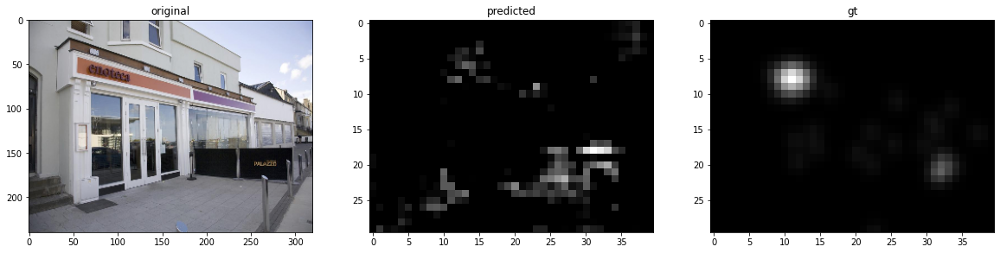

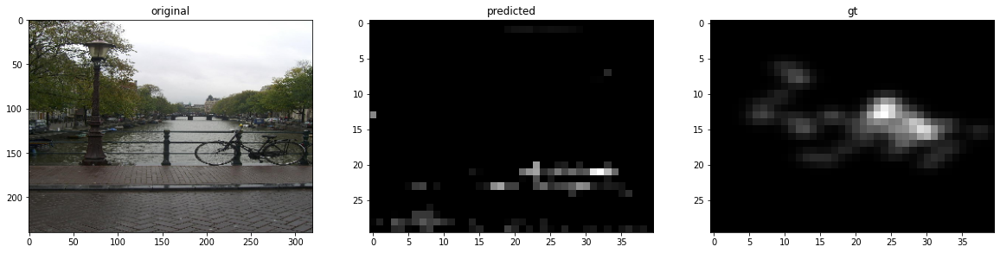

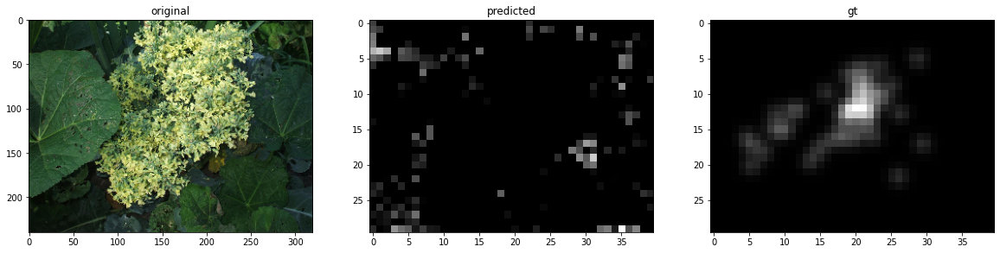

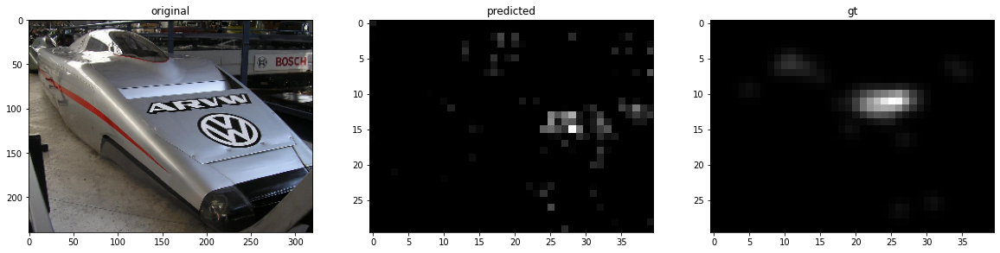

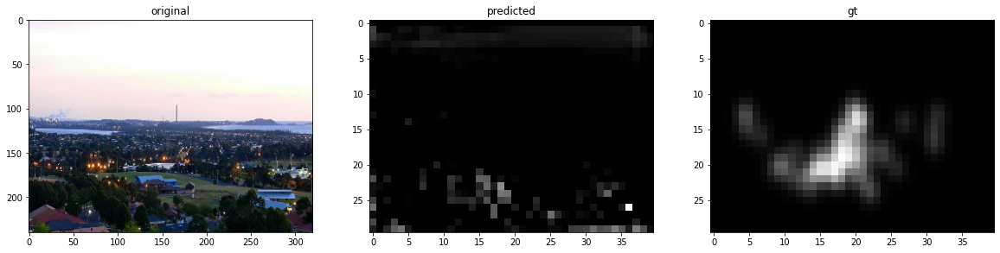

Epochs:0 Images:300 Loss:0.04457145556807518


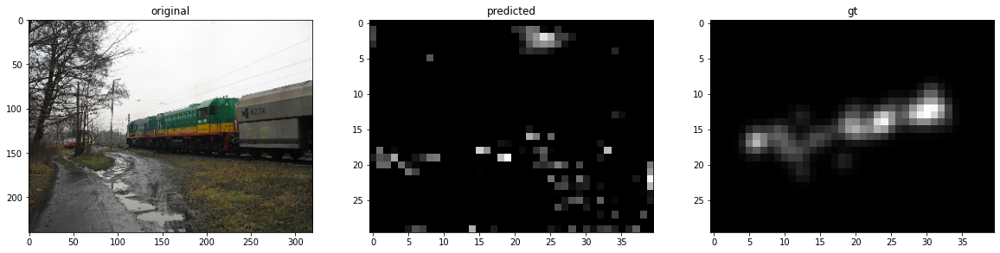

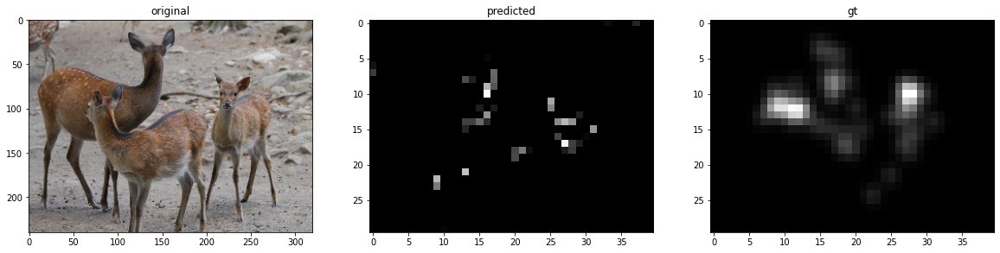

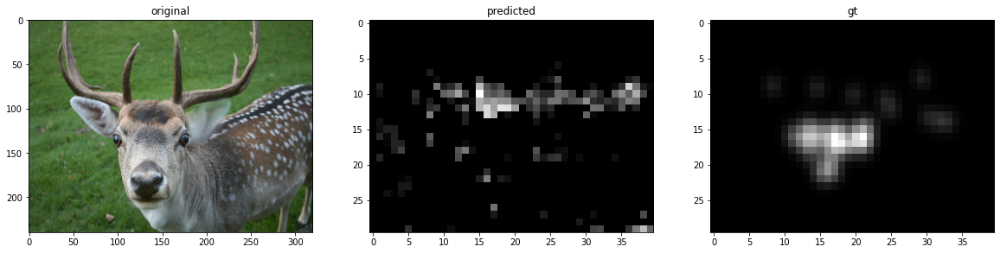

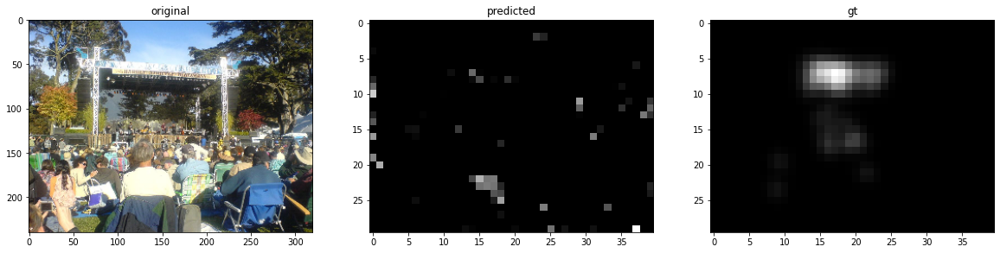

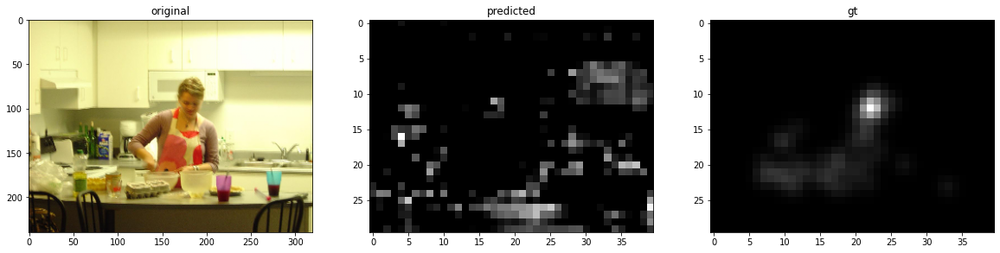

Epochs:0 Images:325 Loss:0.036347243934869766


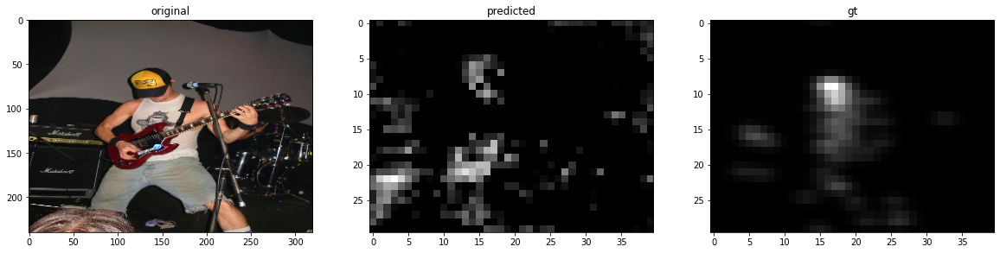

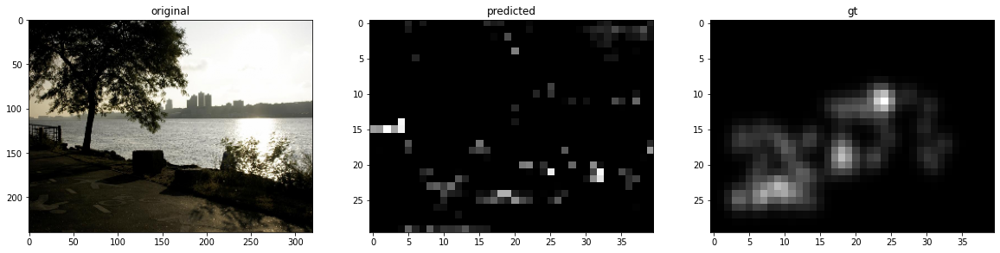

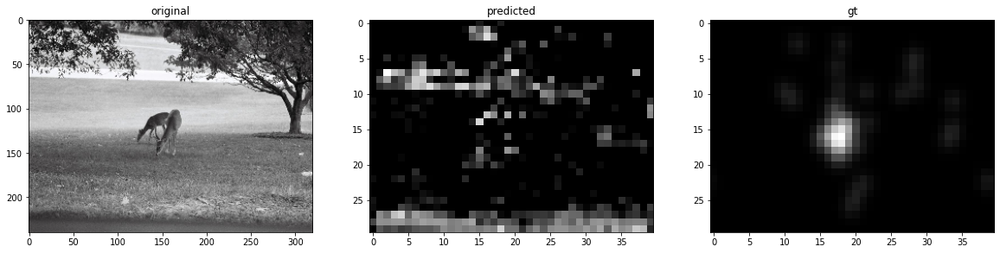

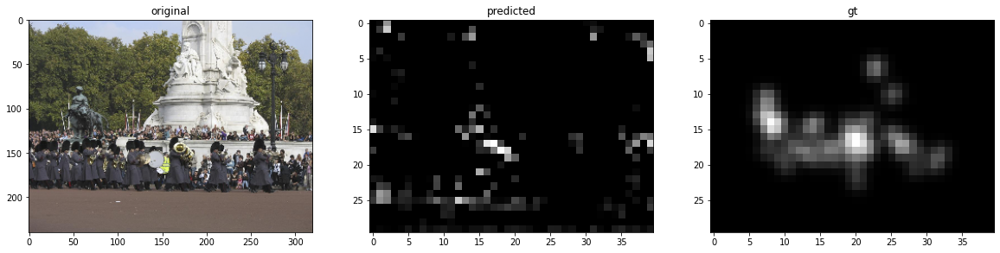

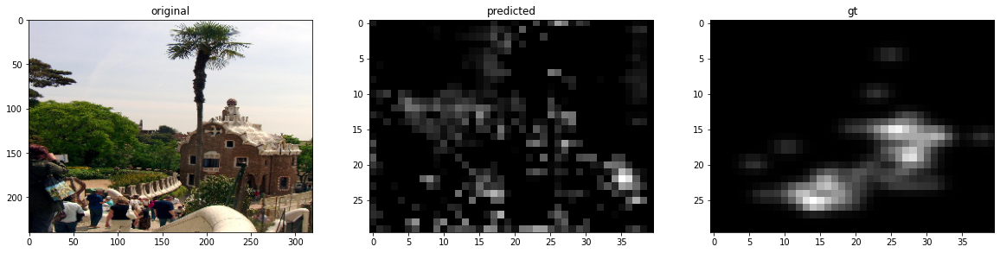

Epochs:0 Images:350 Loss:0.051947083324193954


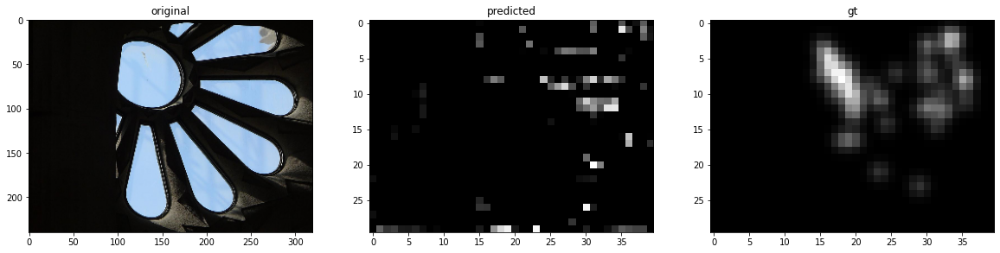

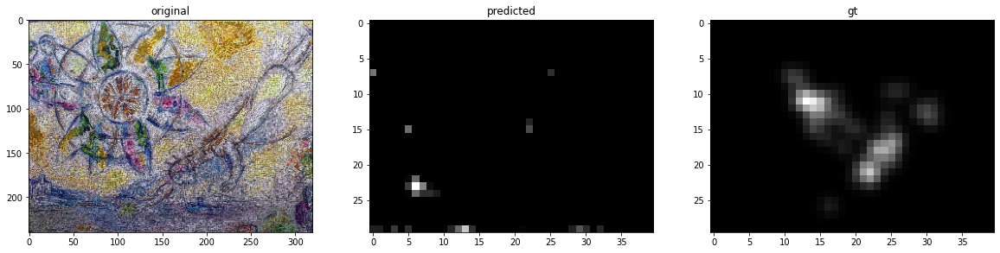

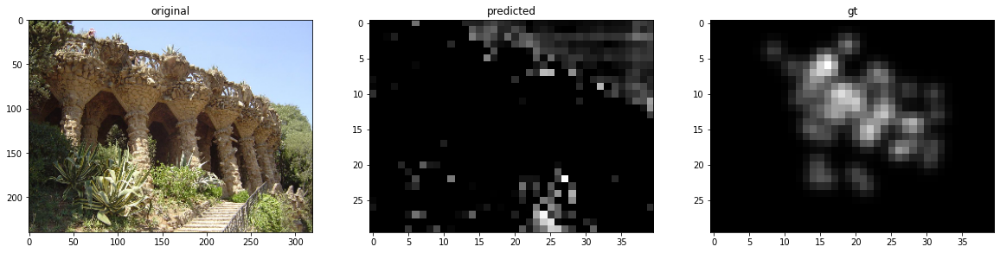

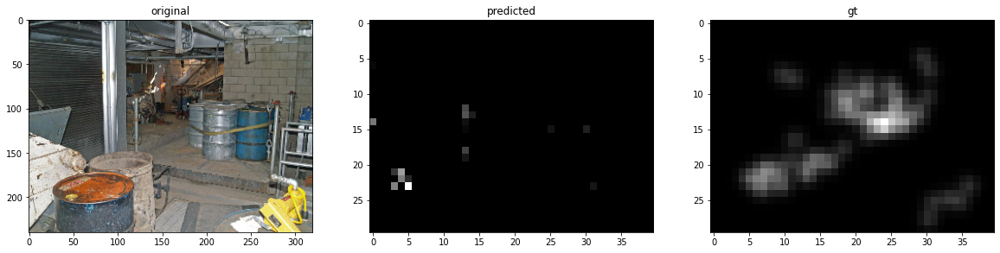

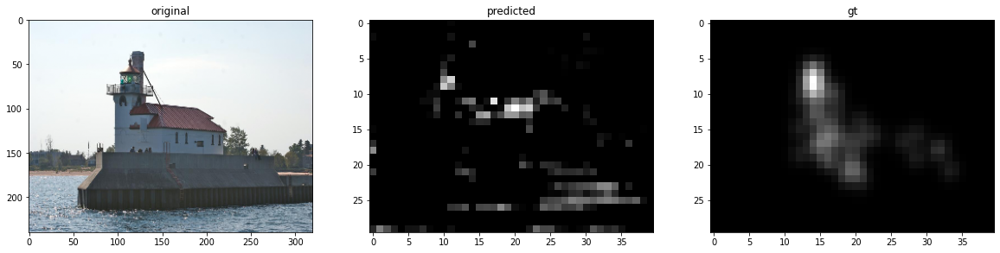

Epochs:0 Images:375 Loss:0.03379544988274574


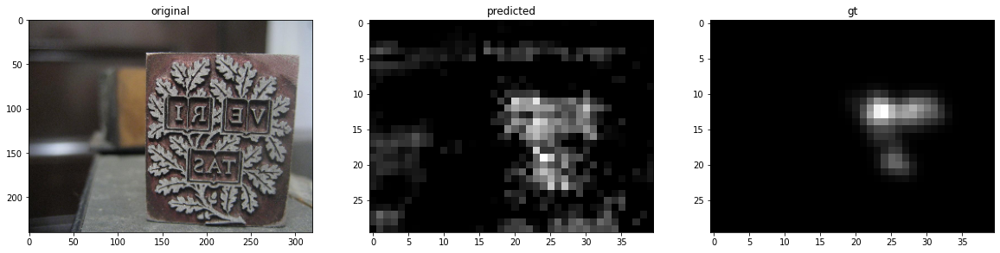

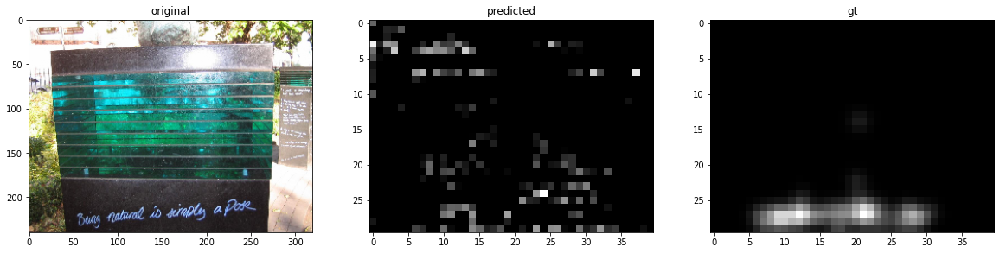

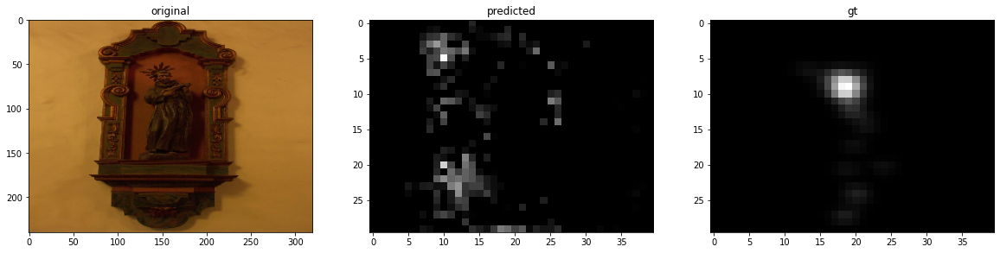

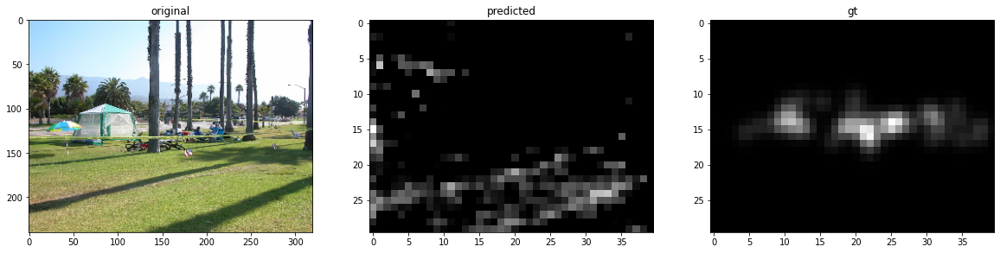

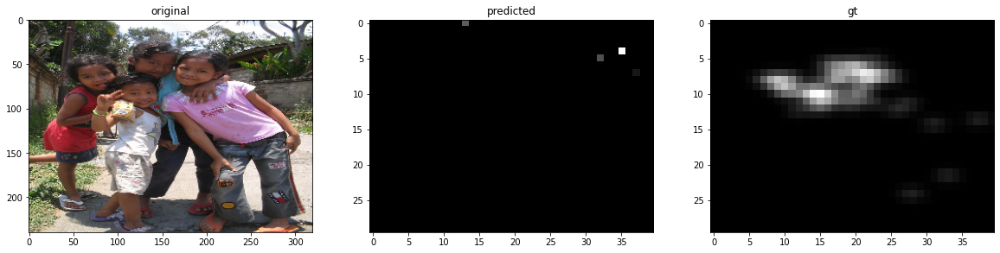

Epochs:0 Images:400 Loss:0.03705599904060364


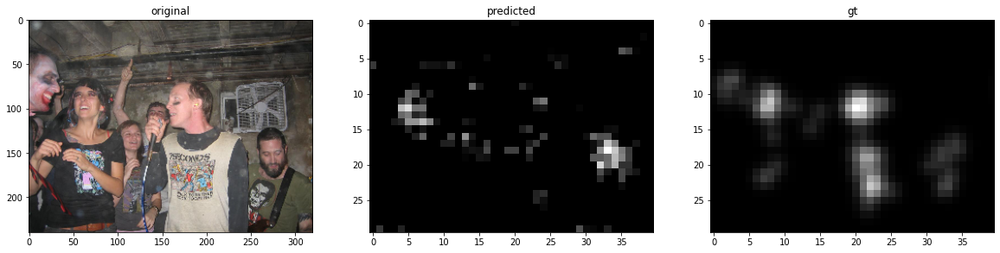

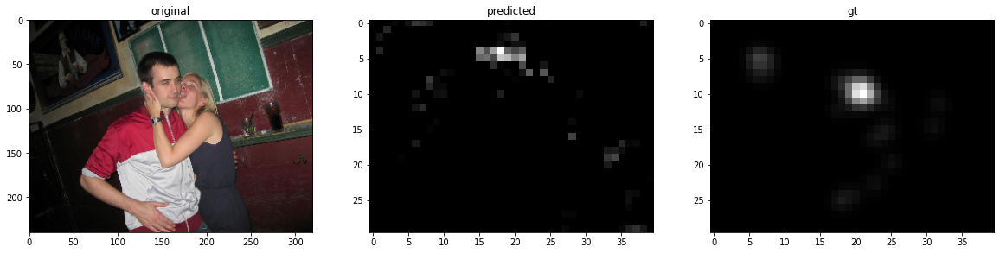

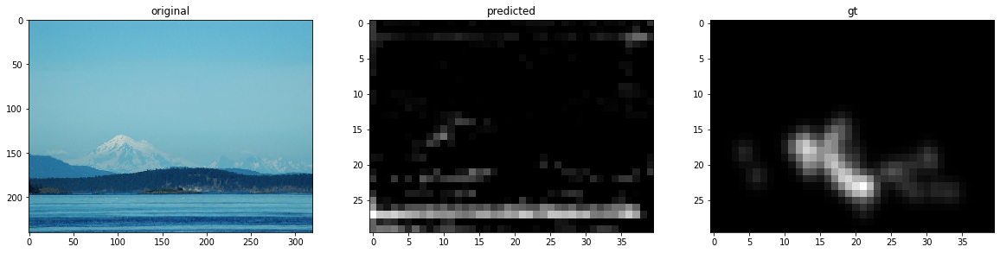

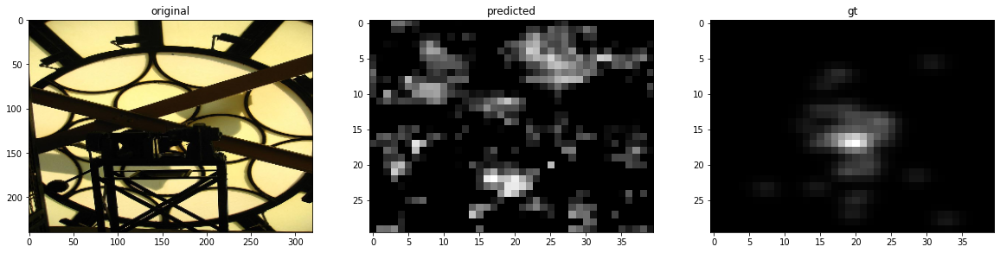

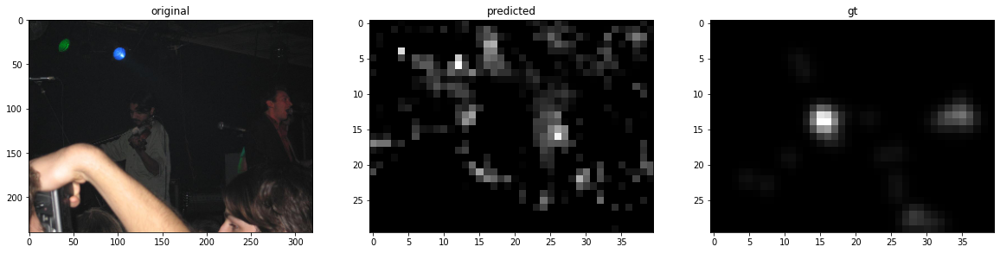

Epochs:0 Images:425 Loss:0.04578980803489685


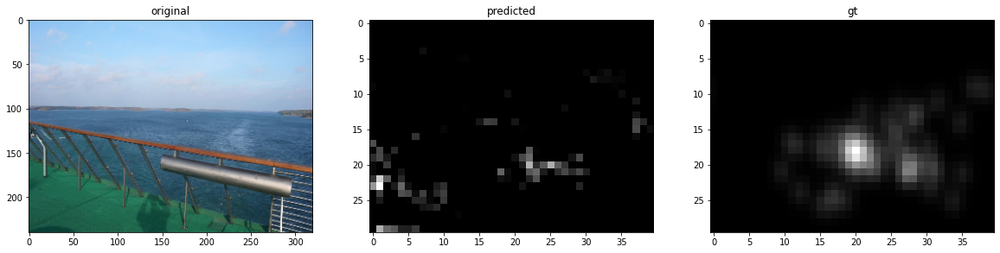

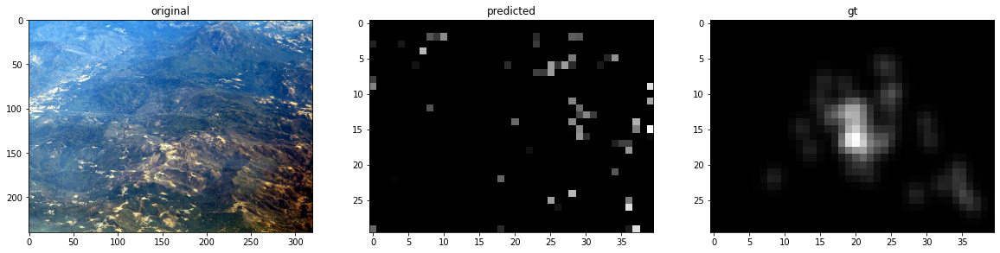

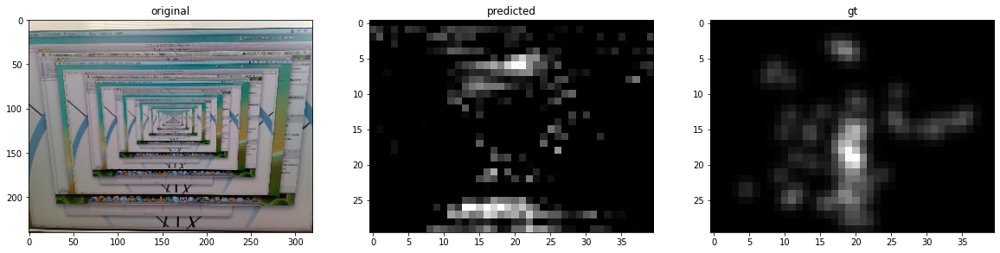

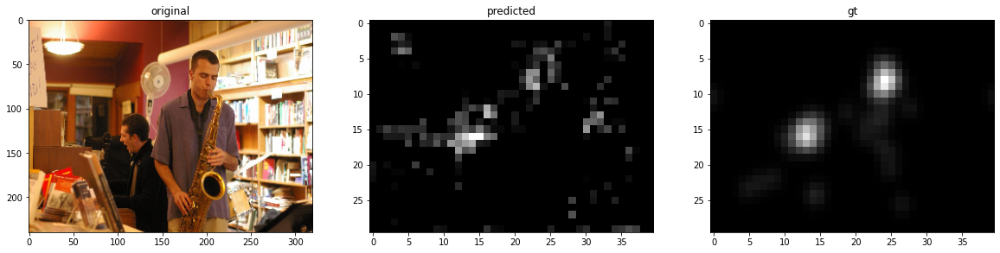

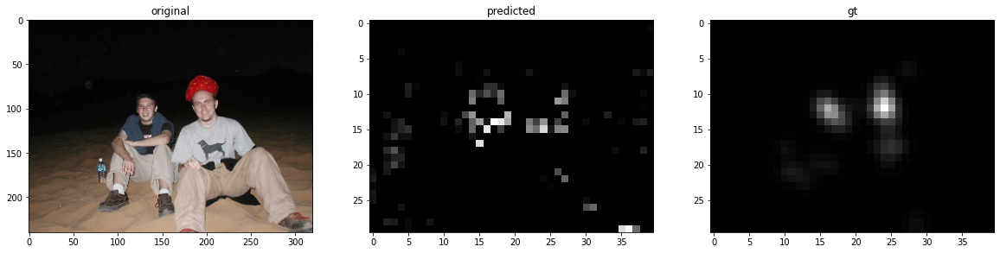

Epochs:0 Images:450 Loss:0.04935188591480255


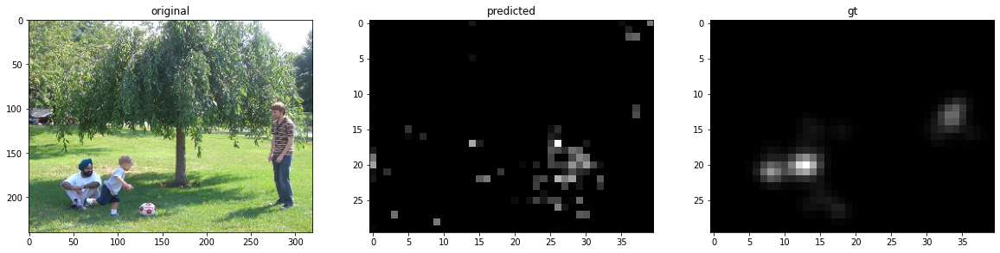

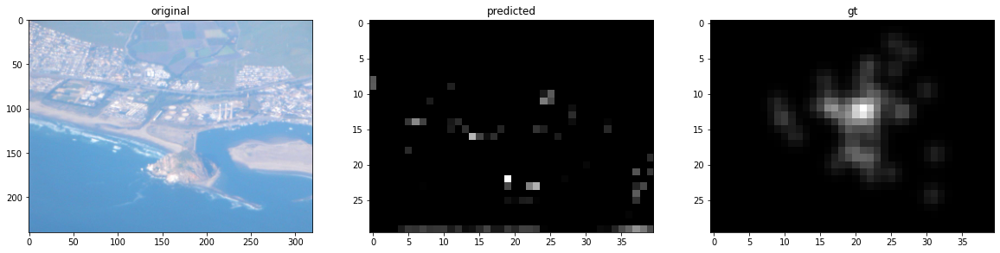

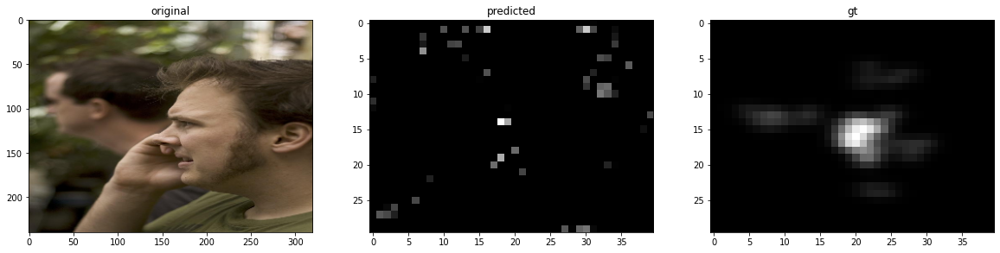

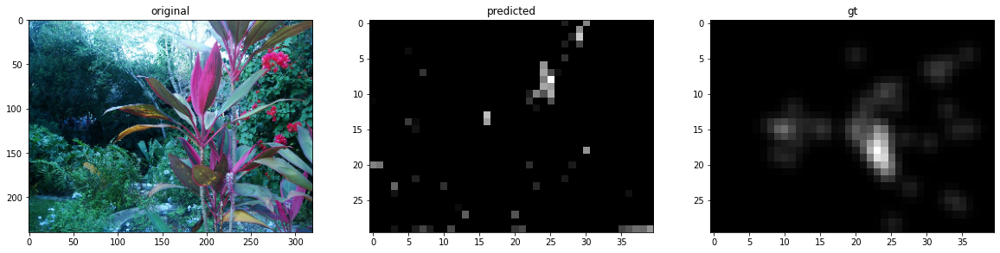

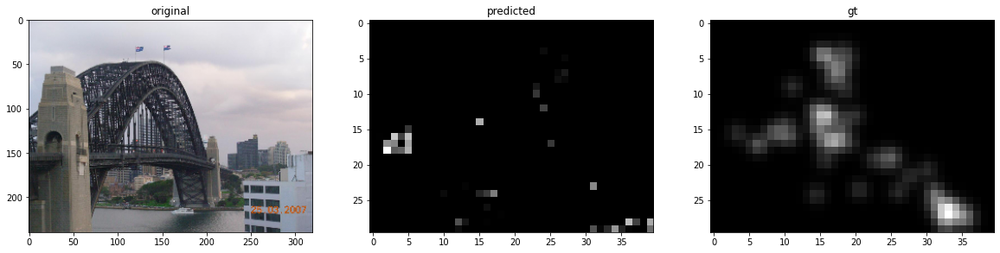

Epochs:0 Images:475 Loss:0.043761201202869415


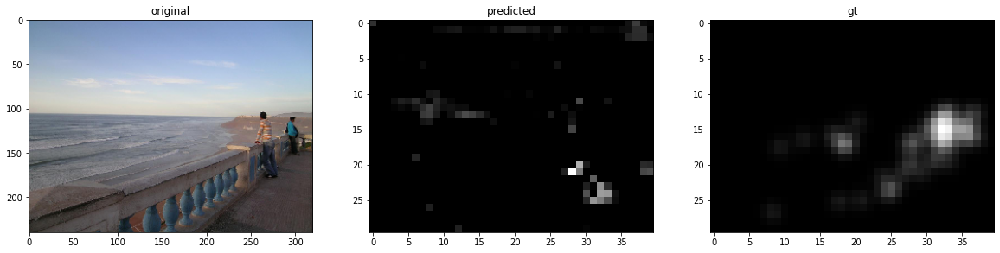

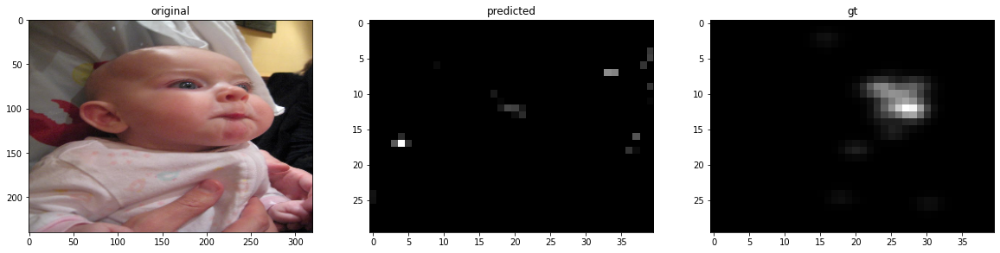

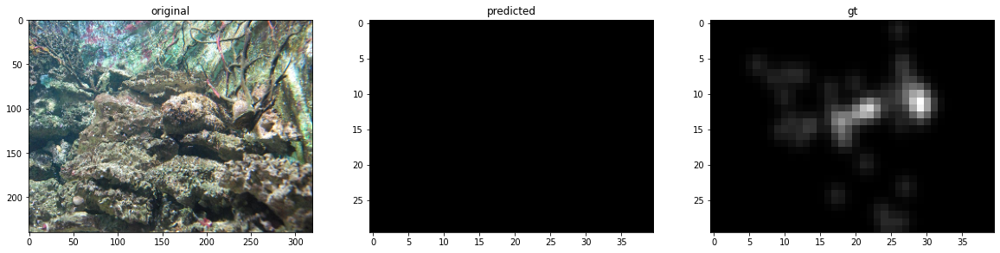

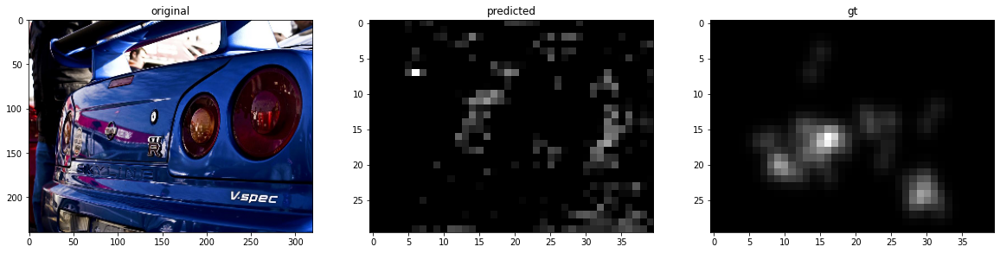

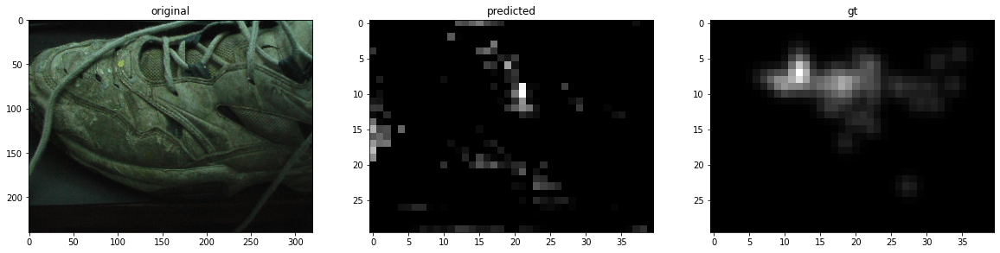

Epochs:0 Images:500 Loss:0.04034997895359993


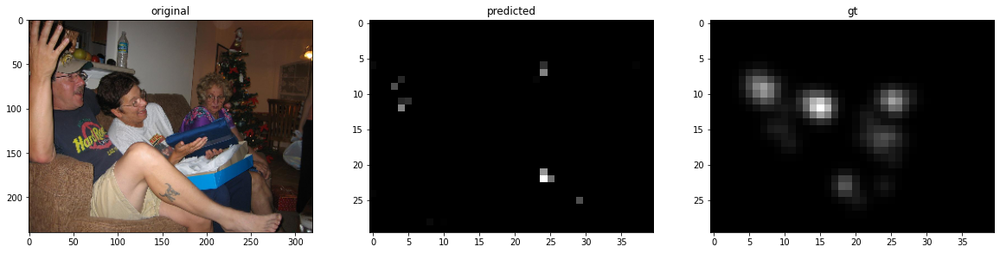

KeyboardInterrupt: ignored

In [19]:
%matplotlib inline
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225])
loss_history = []
nb_epochs = 10
batch_size = 5



for epoch in range(nb_epochs):

  t1 = time.time()
  image_trained = 0
  for i,gt_map in generator(batch_size):

    # org_image = i[0].copy()
    
    # gt = gt_map[0][0]
    # optimizer.zero_grad()
    # i,gt_map = torch.tensor(i.copy(),dtype=torch.float),torch.tensor(gt_map,dtype=torch.float)
    # for idx,x in enumerate(i):
    #   i[idx] = normalize(x)   
    # i,gt_map = i.cuda(),gt_map.cuda()
    # image_trained += batch_size
    # out = model.forward(i)
    # fig = plt.figure(figsize=(20, 20))
    # ax1 = plt.subplot(3, 3, 1)
    # org = np.rollaxis(org_image, 0, 3)
    # ax1.set_title('original')
    # plt.imshow(org)


    # ax1 = plt.subplot(3, 3, 2)
    # ax1.set_title('predicted')
    # plt.imshow(out[0].squeeze(0).data.cpu().numpy(),cmap='gray')

    # ax1 = plt.subplot(3, 3, 3)
    # ax1.set_title('gt')
    # plt.imshow(gt,cmap='gray')
    
    # plt.show()

    #loss = criterion(out,gt_map)
    loss = criterion(out,gt_map,model.prior.clone())
    #print("loss: ",loss)
    #input("Enter")
    loss.backward()
    optimizer.step()
    
    if image_trained % (batch_size*5) == 0:
      print ("Epochs:{} Images:{} Loss:{}".format(epoch,image_trained,loss.item()) )
  t2 = time.time()
  time_per_epoch = (t2 - t1) / 60.0
  print ('Time taken for epoch-{} : {}m'.format(epoch,time_per_epoch))

In [ ]:
## savind model

!mkdir saved_models -p
additional_info = 'my_model'
full_path = 'saved_models/' + str(datetime.datetime.now()) + '_' + additional_info + '.model'
torch.save(model.state_dict(), full_path)

## Model Output 

In [ ]:
# give the path where model is stored
PATH = ''   # path of created model
model.load_state_dict(torch.load(PATH))

In [ ]:
num = 15
cnt = 0
for i,gt_map in generator(1,phase_gen='val'):
    fig = plt.figure(figsize=(20, 20))
    org_image = i[0].copy()
    org_image = np.rollaxis(org_image, 0, 3) 
    i = torch.tensor(i.copy(),dtype=torch.float)
    for idx,x in enumerate(i):
        i[idx] = normalize(x)
    i = i.cuda()
    ax1 = plt.subplot(3, 3, 1)
    ax1.set_title('original')
    plt.imshow(org_image)
    # ax1.plot(org_image)
    out = model.forward(i)
    ax1 = plt.subplot(3, 3, 2)
    ax1.set_title('predicted')
    plt.imshow(out[0].squeeze(0).data.cpu().numpy(),cmap='gray')

    ax1 = plt.subplot(3, 3, 3)
    ax1.set_title('gt')
    plt.imshow(gt_map[0][0],cmap='gray')
    
    plt.show()
    fig.savefig('%s.png'%cnt)
    cnt += 1
    if cnt > num:
      break

In [ ]:
#### comparing 2 models  ## No need to run This

PATH1 = 'saved_models/2019-11-22 07:24:38.815721_my_model.model'
PATH2 = 'saved_models2/2019-11-21 10_43_21.727494_my_model.model'
model1 = MLNet(prior_size).cuda()
model2 = MLNet(prior_size).cuda()

model1.load_state_dict(torch.load(PATH1))
model2.load_state_dict(torch.load(PATH2))


cnt = 0
for i,gt_map in generator(1,phase_gen='val'):
    fig = plt.figure(figsize=(20, 20))
    org_image = i[0].copy()
    org_image = np.rollaxis(org_image, 0, 3) 
    i = torch.tensor(i.copy(),dtype=torch.float)
    for idx,x in enumerate(i):
        i[idx] = normalize(x)
    i = i.cuda()
    ax1 = plt.subplot(4, 4, 1)
    ax1.set_title('original')
    plt.imshow(org_image)
    
    out1 = model1.forward(i)
    out2 = model2.forward(i)
    
    ax1 = plt.subplot(4, 4, 2)
    ax1.set_title('predicted no prior')
    plt.imshow(out1[0].squeeze(0).data.cpu().numpy(),cmap='gray')
    ax1 = plt.subplot(4, 4, 3)
    ax1.set_title('predicted no Prior')
    plt.imshow(out2[0].squeeze(0).data.cpu().numpy(),cmap='gray')

    ax1 = plt.subplot(4, 4, 4)
    ax1.set_title('gt')
    plt.imshow(gt_map[0][0],cmap='gray')
    
    plt.show()
    fig.savefig('%s.png'%visual_cnt)
    cnt += 1
    if cnt > num:
      break


## Run on test set

In [ ]:
# creating dir for storing prediction of test images
! mkdir test_maps

In [ ]:
test_file = [ f for f in os.listdir('test_images/') if f.endswith('.jpg') ]

for i in test_file:
    img = preprocess_images(['test_images/'+i],shape_r,shape_c)
    img = torch.tensor(img.copy(),dtype=torch.float)
    for idx,x in enumerate(img):
        img[idx] = normalize(x)
    img = img.cuda()
    print(i)
    pred = model.forward(img)
    cv2.imwrite('test_maps/' + i[:-3] + 'png',pred[0].squeeze(0).data.cpu().numpy())

# The code below is for the experimental model after removing the prior from the network and changing the loss function

In [ ]:
# for experimental model without the prior
import torch
import torch.nn as nn
import torchvision.models as models


class MLNet(nn.Module):
    
    def __init__(self):
        super(MLNet, self).__init__()
        features = list(models.vgg16(pretrained = True).features)[:-1]
        
        features[23].stride = 1
        features[23].kernel_size = 5
        features[23].padding = 2
                
        self.features = nn.ModuleList(features).eval() 
        self.fddropout = nn.Dropout2d(p=0.5)
        self.int_conv = nn.Conv2d(1280,64,kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        self.pre_final_conv = nn.Conv2d(64,1,kernel_size=(1, 1), stride=(1, 1) ,padding=(0, 0))

    def forward(self, x):
        results = []
        for ii,model in enumerate(self.features):
            x = model(x)
            if ii in {16,23,29}:
                results.append(x)
        x = torch.cat((results[0],results[1],results[2]),1) 
        x = self.fddropout(x)
        # 64 filters convolution layer
        x = self.int_conv(x)
        # 1*1 convolution layer
        x = self.pre_final_conv(x)
        x = torch.nn.functional.relu(x,inplace=True)
        return x

# Modified MSE Loss Function
class ModMSELoss(torch.nn.Module):
    def __init__(self,shape_r_gt,shape_c_gt):
        super(ModMSELoss, self).__init__()
        self.shape_r_gt = shape_r_gt
        self.shape_c_gt = shape_c_gt
        
    def forward(self, output , label ):
        output_max = torch.max(torch.max(output,2)[0],2)[0].unsqueeze(2).unsqueeze(2).expand(output.shape[0],output.shape[1],self.shape_r_gt,self.shape_c_gt)
        loss = torch.mean( ((output / output_max) - label)**2 / (1 - label + 0.1) )  #+  torch.sum(reg)
        return loss

# Input Images size
shape_r = 240
shape_c = 320
shape_r_gt = 30
shape_c_gt = 40

last_freeze_layer = 23

model = MLNet().cuda()
for i,param in enumerate(model.parameters()):
  if i < last_freeze_layer:
    param.requires_grad = False
   
criterion = ModMSELoss(shape_r_gt,shape_c_gt).cuda()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3,weight_decay=1e-4)

In [ ]:
import time
import torchvision.transforms as transforms
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225])

loss_history = []
nb_epochs = 10
batch_size = 16

for epoch in range(nb_epochs):
  t1 = time.time()
  image_trained = 0
  for i,gt_map in generator(batch_size):
      optimizer.zero_grad()
#       print (i.shape)
      i,gt_map = torch.tensor(i.copy(),dtype=torch.float),torch.tensor(gt_map,dtype=torch.float)
      for idx,x in enumerate(i):
        i[idx] = normalize(x)   
      i,gt_map = i.cuda(),gt_map.cuda()
      image_trained += batch_size
      out = model.forward(i)
      loss = criterion(out,gt_map)
      loss.backward()
      optimizer.step()
    
      if image_trained % (batch_size*20) == 0:
        print ("Epochs:{} Images:{} Loss:{}".format(epoch,image_trained,loss.item()) )
  t2 = time.time()
  time_per_epoch = (t2 - t1) / 60.0
  print ('Time taken for epoch-{} : {}m'.format(epoch,time_per_epoch))

In [ ]:
import time
import datetime

# saving model weight
additional_info = 'my_model'
full_path = 'saved_models/' + str(datetime.datetime.now()) + '_' + additional_info + '.model'
torch.save(model.state_dict(), full_path)

In [ ]:
PATH = # path of the saved model
model.load_state_dict(torch.load(PATH))

Now test on some random images from the dataset

In [ ]:

import matplotlib.pyplot as plt
no_visual = 15
visual_cnt = 0
for i,gt_map in generator(1,phase_gen='val'):
    fig = plt.figure(figsize=(20, 20))
    org_image = i[0].copy()
    org_image = np.rollaxis(org_image, 0, 3) 
    i = torch.tensor(i.copy(),dtype=torch.float)
    for idx,x in enumerate(i):
        i[idx] = normalize(x)
    i = i.cuda()
    ax1 = plt.subplot(3, 3, 1)
    ax1.set_title('original')
    plt.imshow(org_image)
    # ax1.plot(org_image)
    out = model.forward(i)
    
    ax1 = plt.subplot(3, 3, 2)
    ax1.set_title('predicted')
    plt.imshow(out[0].squeeze(0).data.cpu().numpy(),cmap='gray')
    
    ax1 = plt.subplot(3, 3, 4)
    ax1.set_title('gt')
    plt.imshow(gt_map[0][0],cmap='gray')
    
    plt.show()
    visual_cnt += 1
    if visual_cnt > no_visual:
      break

## Below code is to run model on video. You have to run this on your pc to get the results as colab don't support this

In [ ]:
full_path = 'saved_models/' + '2019-11-21 10_43_21.727494_my_model' + '.model'
prior_size = (int(shape_r_gt / 10) , int(shape_c_gt / 10))
model = MLNet(prior_size).cuda()
model.load_state_dict(torch.load(full_path))


# Check if camera opened successfully
if (cap.isOpened()== False): 
  print("Error opening video stream or file")


def rescale_frame(frame, percent=75):
    width = int(frame.shape[1] * percent/ 100)
    height = int(frame.shape[0] * percent/ 100)
    dim = (width, height)
    return cv2.resize(frame, dim, interpolation =cv2.INTER_AREA)


# Read until video is completed
while(cap.isOpened()):
  # Capture frame-by-frame
    ret, img2 = cap.read()
    img = img2
    if ret == True:
    
        img = preprocess_images(img,shape_r,shape_c)
        img = torch.tensor(img.copy(),dtype=torch.float)
        for idx,x in enumerate(img):
            img[idx] = normalize(x)
        img = img.cuda()
        
        pred = model.forward(img)
        #    cv2.imwrite('test_maps/' + i[:-3] + 'png',pred[0].squeeze(0).data.cpu().numpy())
            # Display the resulting frame
        img = pred[0].squeeze(0).data.cpu().numpy()
        img = rescale_frame(img, percent=400)
        img = cv2.resize(img, (img.shape[1]*4, img.shape[0]*4))
        cv2.imshow('Frame', img)
        cv2.imshow('frame2', img2)
            # Press Q on keyboard to  exit
        if cv2.waitKey(25) & 0xFF == ord('q'):
			      break
        
  # Break the loop
    else: 
        break
  
# When everything done, release the video capture object
cap.release()
 
# Closes all the frames
cv2.destroyAllWindows()